<a href="https://www.vivaair.com"><img src = "https://upload.wikimedia.org/wikipedia/commons/a/a1/Logosvivaair_Mesa-de-trabajo-1.png" width = 250, align = "Right"></a>

# Fuel Policy / Analytics - OCC
    
***
    
### Descripción:
Este Notebook tiene como objetivo consolidar la base de datos para el desarrollo de una pólitica de combustible para la aerolínea <a href="www.vivaair.com">Viva Air </a> teniendo en cuenta la información meteorológica suministrada por
<a href="https://mesonet.agron.iastate.edu/ASOS/">IOWA State University - MESONET</a>, así como los registros operacionales obtenidos de los archivos Aircraft Journey Log y Fuel Variance




## 1. Master Data Base


In [2]:
#Librerias a utilizar
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os, shutil, datetime
import warnings; warnings.simplefilter('ignore')

%matplotlib inline
pd.set_option('display.max_columns', None)

In [3]:
#Lectura del archivo Aircraft Journey Log, consolidación de campos y creación de nuevas variables

Journey=pd.read_excel('Aircraft Journey Log - VivaAir.xlsx')

Journey['Type AC']=['New' if pd.to_numeric(x[3:])>=5273 else 'Old' for x in Journey['AC']]

Journey['Actual Pax']=[Journey['Actual Pax'][i] 
                       if Journey['Actual Pax'][i]>0 
                       else np.floor(188*Journey['Load Factor (%)'][i]/100) 
                       if Journey['Type AC'][i]=='New' 
                       else np.floor(180*Journey['Load Factor (%)'][i]/100)
                       for i in Journey.index]

Journey['Load Factor (%)']=[Journey['Load Factor (%)'][i] 
                            if Journey['Load Factor (%)'][i]>0 
                            else np.floor(Journey['Actual Pax'][i]/188*100) 
                            if Journey['Type AC'][i]=='New'
                            else np.floor(Journey['Actual Pax'][i]/180*100)
                            for i in Journey.index]

Journey['Load Factor (%)']=[100 if x>100 else x for x in Journey['Load Factor (%)']]

for x in Journey.index:
    if Journey['Type AC'][x]=='New':
         if Journey['Actual Pax'][x]>188:
                Journey['Actual Pax'][x]=188         
    else:
        if Journey['Actual Pax'][x]>180:
                Journey['Actual Pax'][x]=180  
        
Journey['Leg']=Journey['O']+Journey['D']

Filter=((Journey['Serv Type']=='J')&
        (Journey['Cancel']==False)&
        (Journey['Diverted']==False)&
        (Journey['Return to Ramp']==False)&
        (Journey['Returned From Airbone']==False)&
        (Journey['GCD (NM)']>0)&
        (Journey['FH (min)']>0))

Journey['Day']=Journey['Date'].apply(lambda x: x.month)
Journey['Month']=Journey['Date'].apply(lambda x: x.month)
Journey['Year']=Journey['Date'].apply(lambda x: x.year)
Journey['Month-Year'] = Journey['Month'].astype(str)+"/"+Journey['Year'].astype(str)

Journey=Journey[(Filter)]
Journey=Journey[['Op', 'Flight', 'O', 'D', 'Leg', 'Date','Month-Year','Year','Month','Day','ATD (hh:mm)','ATA (hh:mm)','FH (min)','GCD (NM)',       
       'Load Factor (%)','Actual Pax','Type AC','AC']]
Journey.rename(columns={'ATD (hh:mm)':'ATD','ATA (hh:mm)':'ATA','Load Factor (%)':'LF','Actual Pax':'Pax','FH (min)':'Flight Time','GCD (NM)':'Distance'}, inplace=True)

Journey['ATD']=Journey['ATD'].apply(lambda x: x.hour)
Journey['ATA']=Journey['ATA'].apply(lambda x: x.hour)

Journey.set_index(['Flight','Leg', 'Date'], inplace=True)
Journey.head()

,,,Op,O,D,Month-Year,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC
Flight,Leg,Date,,,,,,,,,,,,,,,
748,LIMCUZ,2019-01-01,VPE,LIM,CUZ,1/2019,2019,1,1,7,8,56.0,316,93.0,169.0,Old,HK-5191
8082,MDECTG,2019-01-01,VVC,MDE,CTG,1/2019,2019,1,1,4,5,45.0,257,69.0,130.0,New,HK-5277
800,LIMAQP,2019-01-01,VPE,LIM,AQP,1/2019,2019,1,1,5,6,66.0,414,65.0,118.0,Old,HK-5164
8242,BOGADZ,2019-01-01,VVC,BOG,ADZ,1/2019,2019,1,1,5,7,106.0,652,89.0,169.0,New,HK-5286
400,LIMIQT,2019-01-01,VPE,LIM,IQT,1/2019,2019,1,1,5,7,90.0,543,60.0,109.0,Old,HK-4811


In [4]:
Journey.shape

(50061, 15)

In [5]:
#Lectura del archivo Fuel variance

Fuel=pd.read_excel('Fuel Variance  OCC - VivaAir.xlsx')
Fuel.set_index(['Flight','Leg', 'Date'], inplace=True)
Fuel.rename(columns={'Actual Fuel Burn':'Fuel Burn'}, inplace=True)
Fuel=Fuel[['Fuel Burn']]
Fuel.head()

,,,Fuel Burn
Flight,Leg,Date,
8082,MDECTG,2019-07-01,2100
8289,CTGPEI,2019-07-01,2670
8288,PEICTG,2019-07-01,2370
8083,CTGMDE,2019-07-01,2450
8026,MDECTG,2019-07-01,1870


In [6]:
Fuel.shape

(30925, 1)

In [7]:
#Join entre entre los dos archivos operacionales teniendo como base el Aircraft Journey Log

Master=pd.merge(Journey,Fuel,how='left',left_on=['Flight','Leg', 'Date'],right_on=['Flight','Leg', 'Date'])
Master=Master[Master['Fuel Burn']>0]
Master.reset_index(inplace=True)
Master.head()

,Flight,Leg,Date,Op,O,D,Month-Year,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn
0,8326,BOGADZ,2019-07-01,VVC,BOG,ADZ,7/2019,2019,7,7,0,2,108.0,652,100.0,188.0,New,HK-5320,4660.0
1,8327,ADZBOG,2019-07-01,VVC,ADZ,BOG,7/2019,2019,7,7,3,5,103.0,652,100.0,188.0,New,HK-5320,4460.0
2,748,LIMCUZ,2019-07-01,VPE,LIM,CUZ,7/2019,2019,7,7,4,5,61.0,316,70.0,132.0,New,HK-5277,2680.0
3,110,LIMCIX,2019-07-01,VPE,LIM,CIX,7/2019,2019,7,7,4,6,63.0,353,71.0,135.0,New,HK-5286,2700.0
4,800,LIMAQP,2019-07-01,VPE,LIM,AQP,7/2019,2019,7,7,5,6,65.0,414,82.0,156.0,New,HK-5273,2980.0


In [8]:
Master.shape

(30666, 19)

In [9]:
#Check missing values

missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())

In [10]:
#Creación de función Percentil

def P(n):
    def P_(x):
        return np.percentile(x, n)
    P_.__name__ = 'P_%s' % n
    return P_

In [11]:
#Estimación de mediana de Fuel Burn como parametro de referencia + Join del campo a Data frame principal

MedianDF=Master[['Leg','Fuel Burn']].groupby('Leg')['Fuel Burn'].agg([np.mean,np.std,np.min,P(25),np.median,P(75),np.max]).reset_index()
MedianDF.rename(columns={"mean": "Fuel Burn mean","std":"Fuel Burn std","amin":"Fuel Burn min"
                         ,"P_25":"Fuel Burn P25","median":"Fuel Burn Median","P_75":"Fuel Burn P75","amax":"Fuel Burn max"},inplace=True)

Master=pd.merge(Master,MedianDF,how='left',left_on=['Leg'],right_on=['Leg'])
Master.head()


,Flight,Leg,Date,Op,O,D,Month-Year,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max
0,8326,BOGADZ,2019-07-01,VVC,BOG,ADZ,7/2019,2019,7,7,0,2,108.0,652,100.0,188.0,New,HK-5320,4660.0,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.0,10200.0
1,8327,ADZBOG,2019-07-01,VVC,ADZ,BOG,7/2019,2019,7,7,3,5,103.0,652,100.0,188.0,New,HK-5320,4460.0,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.0,8560.0
2,748,LIMCUZ,2019-07-01,VPE,LIM,CUZ,7/2019,2019,7,7,4,5,61.0,316,70.0,132.0,New,HK-5277,2680.0,2683.991471,951.931563,730.0,2490.0,2580.0,2700.0,8360.0
3,110,LIMCIX,2019-07-01,VPE,LIM,CIX,7/2019,2019,7,7,4,6,63.0,353,71.0,135.0,New,HK-5286,2700.0,2872.830508,978.509750,810.0,2669.0,2760.0,2876.5,8930.0
4,800,LIMAQP,2019-07-01,VPE,LIM,AQP,7/2019,2019,7,7,5,6,65.0,414,82.0,156.0,New,HK-5273,2980.0,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.0,10100.0


In [12]:
Master.shape

(30666, 26)

In [13]:
#Check missing values

missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())

In [14]:
CopyMaster=Master.copy()

In [15]:
Master=CopyMaster.copy() 

In [16]:
#Estimación de consumo de combustible adicional en base al valor de referencia de cada vuelo + Join del campo a Data frame principal


FuelPenalty=pd.read_excel('Fuel Penalty 1000 Kg - VivaAir.xlsx')
Master=pd.merge(Master,FuelPenalty,how='left',left_on='Leg',right_on='Leg')

Master['Fuel Penalty'].fillna(np.mean(Master['Fuel Penalty']),inplace=True)

Master['Add Fuel']=[0 if Master['Fuel Burn'][x]<=Master["Fuel Burn Median"][x] 
                    else float((Master['Fuel Burn'][x]-Master["Fuel Burn Median"][x])/(1+(Master['Fuel Penalty'][x]/1000)))
                   for x in Master.index]

#Imputación

Master=Master[Master['Add Fuel']<3000]
Master.head()

,Flight,Leg,Date,Op,O,D,Month-Year,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max,Fuel Penalty,Add Fuel
0,8326,BOGADZ,2019-07-01,VVC,BOG,ADZ,7/2019,2019,7,7,0,2,108.0,652,100.0,188.0,New,HK-5320,4660.0,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.0,10200.0,49.0,448.045758
1,8327,ADZBOG,2019-07-01,VVC,ADZ,BOG,7/2019,2019,7,7,3,5,103.0,652,100.0,188.0,New,HK-5320,4460.0,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.0,8560.0,50.0,200.000000
2,748,LIMCUZ,2019-07-01,VPE,LIM,CUZ,7/2019,2019,7,7,4,5,61.0,316,70.0,132.0,New,HK-5277,2680.0,2683.991471,951.931563,730.0,2490.0,2580.0,2700.0,8360.0,28.0,97.276265
3,110,LIMCIX,2019-07-01,VPE,LIM,CIX,7/2019,2019,7,7,4,6,63.0,353,71.0,135.0,New,HK-5286,2700.0,2872.830508,978.509750,810.0,2669.0,2760.0,2876.5,8930.0,32.0,0.000000
4,800,LIMAQP,2019-07-01,VPE,LIM,AQP,7/2019,2019,7,7,5,6,65.0,414,82.0,156.0,New,HK-5273,2980.0,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.0,10100.0,34.0,29.013540


In [17]:
Master.shape

(30498, 28)

In [18]:
#Check missing values

missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())

In [19]:
#Selección de aeropuertos a consultar METAR en base al data frame principal https://ourairports.com/data/

Countries={'test':list(Master['D'].unique())}

airports=pd.read_csv("airports.csv")

airports=airports[(airports["scheduled_service"]=='yes') & (airports["type"].str.contains("medium") | airports["type"].str.contains("large"))]
airports.drop(["id", "ident", "iso_region","continent","type","scheduled_service","local_code","home_link","wikipedia_link","keywords"],axis=1,inplace=True)

request=[]
for i in Countries:
    for j in Countries.get(i):
        request.append(j)
        
airports=airports[airports['iata_code'].isin(request)]
airports.set_index("iata_code",inplace=True)
airports.head(5)

,name,latitude_deg,longitude_deg,elevation_ft,iso_country,municipality,gps_code
iata_code,,,,,,,
MIA,Miami International Airport,25.79320,-80.290604,8.0,US,Miami,KMIA
BGA,Palonegro Airport,7.12650,-73.184800,3897.0,CO,Bucaramanga,SKBG
BOG,El Dorado International Airport,4.70159,-74.146900,8361.0,CO,Bogota,SKBO
BAQ,Ernesto Cortissoz International Airport,10.88960,-74.780800,98.0,CO,Barranquilla,SKBQ
CUC,Camilo Daza International Airport,7.92757,-72.511500,1096.0,CO,Cúcuta,SKCC


In [20]:
#Get data from IOWA State University - Mesonet
def getdata(stationslist,year=3,df=airports,adjUTC=-5):
    
    #stationlist: Listado de estaciones 
    if year<=0:
        year=1
    
    url="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?"

    for i in stationslist:
        url=url+"station="+str(df.at[i,'gps_code'])+"&"

    #Temperauture (°C)//Wind Direction//Wind Speed (Knots)//Visibility (miles)
    #Cloud Coverage//Cloud Height Level (ft)//Present Wx Codes
    
    url=url+"data=tmpc&data=drct&data=sknt&data=vsby&data=skyl1&data=wxcodes&"
    
    date2=datetime.datetime.utcnow().date() - datetime.timedelta(days=1)
    y2=str(date2.year)
    m2=str(date2.month)
    d2=str(date2.day)
    y1=str(date2.year-year)
    
    #Date from-to
    url=url+"&year1="+y1+"&month1=1&day1=1&year2="+y2+"&month2="+m2+"&day2="+d2
    
    #Missing valueas as null, download directly as txt fiile    
    url=url+"&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=null&trace=null&direct=yes&report_type=1&report_type=2"
    
    print("Link de descarga manual:")
    print(url)
    data=pd.read_csv(url)
    
    data["valid"]=pd.to_datetime(data["valid"])
    data["Year"]= pd.DatetimeIndex(data["valid"]).year
    data["Month"]= pd.DatetimeIndex(data["valid"]).month
    data["Day"]= pd.DatetimeIndex(data["valid"]).day
    data["Hour UTC"]= pd.DatetimeIndex(data["valid"]).hour
    data["Hour LT"]= pd.DatetimeIndex(data["valid"]+datetime.timedelta(hours=adjUTC)).hour
    data["Rain"]=data['wxcodes'].str.contains('RA').fillna(False).astype(int)*100

    data["Fog-Brume"]=(data['wxcodes'].str.contains('FG')|data['wxcodes'].str.contains('BR')|(data['wxcodes'].str.contains('HZ'))).fillna(False).astype(int)*100
    data["Thunder"]=data['wxcodes'].str.contains('TS').fillna(False).astype(int)*100
    data["Snow"]=data['wxcodes'].str.contains('SN').fillna(False).astype(int)*100
    data["Op constraint"]=((data["Fog-Brume"]==100) | (data["Thunder"]==100)).astype(int)*100
    data.rename(columns={"station":"OACI","tmpc": "Temperature","drct": "Wind Dir","vsby":"H Vsby","skyl1":"V Vsby","sknt": "Wind"},inplace=True)
    data.drop(['valid', 'wxcodes'], axis=1, inplace=True)
    
    df2=df['gps_code'].to_frame().reset_index()
    data=pd.merge(left=data, right=df2, how='left', left_on='OACI', right_on='gps_code')
    
    data.rename(columns={"iata_code":"IATA"},inplace=True)
    data['IATA']=data['IATA'].fillna(data['OACI'])
    data.drop(['gps_code'], axis=1, inplace=True)
    
    data=data[['IATA','OACI', 'Temperature', 'Wind Dir', 'Wind', 'H Vsby', 'V Vsby',
               'Year','Month','Day', 'Hour UTC', 'Hour LT', 'Rain', 'Fog-Brume', 'Thunder', 'Snow','Op constraint']]
    
    return data

In [21]:
#Consulta de los registros meteorologicos para los aeropuertos operados por la aerolinea

Wx=getdata(request)
Wx.shape

Link de descarga manual:
https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station=SKSP&station=SKBO&station=SPZO&station=SPHI&station=SPQU&station=SKMR&station=SKBQ&station=SPQT&station=SKRG&station=SPJC&station=SKRH&station=SKCG&station=SPJR&station=SKSM&station=SPUR&station=SKPE&station=SPTN&station=SPJE&station=SKCC&station=SPYL&station=SKBG&station=KMIA&station=SPST&station=SKLT&station=SPJL&station=TNCC&station=SKCL&data=tmpc&data=drct&data=sknt&data=vsby&data=skyl1&data=wxcodes&&year1=2017&month1=1&day1=1&year2=2020&month2=10&day2=3&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=null&trace=null&direct=yes&report_type=1&report_type=2


(1127580, 17)

In [22]:
#Consolidación de base de datos Operacionales + registro meteorologicos

Wx.rename(columns={'IATA':'D','Hour LT':'Hour'},inplace=True)
Wx.set_index(['D','Year','Month','Day','Hour'], inplace=True)

Wx=Wx[~Wx.index.duplicated(keep="last")]
Wx.reset_index(inplace=True)

Master=pd.merge(Master,Wx,how='left',left_on=['D','Year','Month','Day','ATA'],right_on=['D','Year','Month','Day','Hour'])
Master.set_index(['Flight','Date','ATA'], inplace=True)

Master=Master[~Master.index.duplicated(keep="last")]
Master.reset_index(inplace=True)

#Imputación de datos

Master=Master[~Master['Hour'].isnull()]

Master.head()

,Flight,Date,ATA,Leg,Op,O,D,Month-Year,Year,Month,Day,ATD,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max,Fuel Penalty,Add Fuel,Hour,OACI,Temperature,Wind Dir,Wind,H Vsby,V Vsby,Hour UTC,Rain,Fog-Brume,Thunder,Snow,Op constraint
0,8326,2019-07-01,2,BOGADZ,VVC,BOG,ADZ,7/2019,2019,7,7,0,108.0,652,100.0,188.0,New,HK-5320,4660.0,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.0,10200.0,49.0,448.045758,2.0,SKSP,28.0,60.0,7.0,6.21,1400.0,7.0,0.0,0.0,0.0,0.0,0.0
1,8327,2019-07-01,5,ADZBOG,VVC,ADZ,BOG,7/2019,2019,7,7,3,103.0,652,100.0,188.0,New,HK-5320,4460.0,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.0,8560.0,50.0,200.000000,5.0,SKBO,12.0,90.0,6.0,6.21,1700.0,10.0,0.0,0.0,0.0,0.0,0.0
2,748,2019-07-01,5,LIMCUZ,VPE,LIM,CUZ,7/2019,2019,7,7,4,61.0,316,70.0,132.0,New,HK-5277,2680.0,2683.991471,951.931563,730.0,2490.0,2580.0,2700.0,8360.0,28.0,97.276265,5.0,SPZO,2.0,NaN,1.0,6.21,3000.0,10.0,0.0,0.0,0.0,0.0,0.0
3,110,2019-07-01,6,LIMCIX,VPE,LIM,CIX,7/2019,2019,7,7,4,63.0,353,71.0,135.0,New,HK-5286,2700.0,2872.830508,978.509750,810.0,2669.0,2760.0,2876.5,8930.0,32.0,0.000000,6.0,SPHI,17.0,NaN,2.0,6.21,NaN,11.0,0.0,0.0,0.0,0.0,0.0
4,800,2019-07-01,6,LIMAQP,VPE,LIM,AQP,7/2019,2019,7,7,5,65.0,414,82.0,156.0,New,HK-5273,2980.0,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.0,10100.0,34.0,29.013540,6.0,SPQU,10.0,50.0,7.0,6.21,NaN,11.0,0.0,0.0,0.0,0.0,0.0


In [23]:
Master.shape

(29384, 41)

In [24]:
#Check missing values

missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())

False    29081
True       303
Name: Temperature, dtype: int64
False    25444
True      3940
Name: Wind Dir, dtype: int64
False    29313
True        71
Name: Wind, dtype: int64
False    29266
True       118
Name: H Vsby, dtype: int64
False    26358
True      3026
Name: V Vsby, dtype: int64


In [25]:
#imputación de datos faltantes

Master['Temperature'] = Master[['D','Temperature']].groupby("D").transform(lambda x: x.fillna(x.mean()))
Master['Wind'] = Master[['D','Wind']].groupby("D").transform(lambda x: x.fillna(x.mean()))
Master['Wind Dir'] = Master[['D','Wind Dir']].groupby("D").transform(lambda x: x.fillna(x.mean()))
Master['H Vsby'] = Master[['D','H Vsby']].groupby("D").transform(lambda x: x.fillna(x.max()))
Master['V Vsby'] = Master[['D','V Vsby']].groupby("D").transform(lambda x: x.fillna(x.max()))

#Check missing values

missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())

In [26]:
#Estimación valores de referencia para el tiempo de vulo + Join d los campos al Data frame principal

summ=Master[['Leg','Flight Time']].groupby('Leg')['Flight Time'].agg([np.mean,np.std,np.min,P(25),np.median,P(75),np.max])
summ.rename(columns={"mean": "Flight Time mean","std":"Flight Time std","amin":"Flight Time min","P_25":"Flight Time P25","median":"Flight Time median","P_75":"Flight Time P75","amax":"Flight Time max"},inplace=True)
Master=pd.merge(Master,summ,how='left',left_on=['Leg'],right_on=['Leg'])
Master.head()

,Flight,Date,ATA,Leg,Op,O,D,Month-Year,Year,Month,Day,ATD,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max,Fuel Penalty,Add Fuel,Hour,OACI,Temperature,Wind Dir,Wind,H Vsby,V Vsby,Hour UTC,Rain,Fog-Brume,Thunder,Snow,Op constraint,Flight Time mean,Flight Time std,Flight Time min,Flight Time P25,Flight Time median,Flight Time P75,Flight Time max
0,8326,2019-07-01,2,BOGADZ,VVC,BOG,ADZ,7/2019,2019,7,7,0,108.0,652,100.0,188.0,New,HK-5320,4660.0,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.0,10200.0,49.0,448.045758,2.0,SKSP,28.0,60.000000,7.0,6.21,1400.0,7.0,0.0,0.0,0.0,0.0,0.0,102.542042,5.758462,96.0,100.0,101.0,103.0,165.0
1,8327,2019-07-01,5,ADZBOG,VVC,ADZ,BOG,7/2019,2019,7,7,3,103.0,652,100.0,188.0,New,HK-5320,4460.0,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.0,8560.0,50.0,200.000000,5.0,SKBO,12.0,90.000000,6.0,6.21,1700.0,10.0,0.0,0.0,0.0,0.0,0.0,100.855655,4.905819,89.0,98.0,100.0,103.0,133.0
2,748,2019-07-01,5,LIMCUZ,VPE,LIM,CUZ,7/2019,2019,7,7,4,61.0,316,70.0,132.0,New,HK-5277,2680.0,2683.991471,951.931563,730.0,2490.0,2580.0,2700.0,8360.0,28.0,97.276265,5.0,SPZO,2.0,147.440945,1.0,6.21,3000.0,10.0,0.0,0.0,0.0,0.0,0.0,57.689011,6.443030,43.0,54.0,56.0,59.0,133.0
3,110,2019-07-01,6,LIMCIX,VPE,LIM,CIX,7/2019,2019,7,7,4,63.0,353,71.0,135.0,New,HK-5286,2700.0,2872.830508,978.509750,810.0,2669.0,2760.0,2876.5,8930.0,32.0,0.000000,6.0,SPHI,17.0,184.078014,2.0,6.21,5000.0,11.0,0.0,0.0,0.0,0.0,0.0,63.250871,1.833962,58.0,62.0,63.0,64.0,70.0
4,800,2019-07-01,6,LIMAQP,VPE,LIM,AQP,7/2019,2019,7,7,5,65.0,414,82.0,156.0,New,HK-5273,2980.0,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.0,10100.0,34.0,29.013540,6.0,SPQU,10.0,50.000000,7.0,6.21,13000.0,11.0,0.0,0.0,0.0,0.0,0.0,64.841880,3.663671,60.0,64.0,65.0,66.0,115.0


In [27]:
missing_data = Master.isnull()

for column in Master.columns[Master.isnull().any()].tolist():
    print (missing_data[column].value_counts())


In [28]:
CopyMaster=Master.copy()

Master=Master[['Add Fuel','Flight', 'Date',  'Leg', 'Op', 'O', 'D', 'Year',
       'Month', 'Day', 'ATD','ATA', 'Flight Time', 'Distance', 'LF', 'Pax',
       'Type AC', 'AC',"Fuel Burn mean","Fuel Burn std","Fuel Burn min",
        "Fuel Burn P25","Fuel Burn Median","Fuel Burn P75","Fuel Burn max", 'Fuel Penalty',
       'Temperature', 'Wind Dir', 'Wind', 'H Vsby',
       'V Vsby', 'Rain', 'Fog-Brume', 'Thunder', 'Snow',
       'Op constraint', 'Flight Time mean', 'Flight Time std', 'Flight Time min', 'Flight Time P25', 'Flight Time median',
       'Flight Time P75', 'Flight Time max']]

In [29]:
pd.set_option('display.max_columns', None)

In [30]:
Master.to_excel("Master Data Base - Viva Air.xlsx")
Master

,Add Fuel,Flight,Date,Leg,Op,O,D,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max,Fuel Penalty,Temperature,Wind Dir,Wind,H Vsby,V Vsby,Rain,Fog-Brume,Thunder,Snow,Op constraint,Flight Time mean,Flight Time std,Flight Time min,Flight Time P25,Flight Time median,Flight Time P75,Flight Time max
0,448.045758,8326,2019-07-01,BOGADZ,VVC,BOG,ADZ,2019,7,7,0,2,108.0,652,100.0,188.0,New,HK-5320,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.00,10200.0,49.0,28.0,60.000000,7.0,6.21,1400.0,0.0,0.0,0.0,0.0,0.0,102.542042,5.758462,96.0,100.0,101.0,103.0,165.0
1,200.000000,8327,2019-07-01,ADZBOG,VVC,ADZ,BOG,2019,7,7,3,5,103.0,652,100.0,188.0,New,HK-5320,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.00,8560.0,50.0,12.0,90.000000,6.0,6.21,1700.0,0.0,0.0,0.0,0.0,0.0,100.855655,4.905819,89.0,98.0,100.0,103.0,133.0
2,97.276265,748,2019-07-01,LIMCUZ,VPE,LIM,CUZ,2019,7,7,4,5,61.0,316,70.0,132.0,New,HK-5277,2683.991471,951.931563,730.0,2490.0,2580.0,2700.00,8360.0,28.0,2.0,147.440945,1.0,6.21,3000.0,0.0,0.0,0.0,0.0,0.0,57.689011,6.443030,43.0,54.0,56.0,59.0,133.0
3,0.000000,110,2019-07-01,LIMCIX,VPE,LIM,CIX,2019,7,7,4,6,63.0,353,71.0,135.0,New,HK-5286,2872.830508,978.509750,810.0,2669.0,2760.0,2876.50,8930.0,32.0,17.0,184.078014,2.0,6.21,5000.0,0.0,0.0,0.0,0.0,0.0,63.250871,1.833962,58.0,62.0,63.0,64.0,70.0
4,29.013540,800,2019-07-01,LIMAQP,VPE,LIM,AQP,2019,7,7,5,6,65.0,414,82.0,156.0,New,HK-5273,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.00,10100.0,34.0,10.0,50.000000,7.0,6.21,13000.0,0.0,0.0,0.0,0.0,0.0,64.841880,3.663671,60.0,64.0,65.0,66.0,115.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29379,0.000000,8090,2020-03-24,PEICTG,VVC,PEI,CTG,2020,3,3,20,21,55.0,339,29.0,56.0,New,HK-5305,2352.506470,311.111143,680.0,2250.0,2320.0,2430.00,6620.0,27.0,27.0,70.000000,7.0,6.21,2500.0,0.0,0.0,0.0,0.0,0.0,57.071006,2.959357,52.0,55.0,56.0,58.0,84.0
29380,0.000000,8142,2020-03-24,MDECTG,VVC,MDE,CTG,2020,3,3,19,20,41.0,268,16.0,31.0,New,HK-5274,1822.849549,309.527194,610.0,1720.0,1780.0,1890.00,6820.0,22.0,27.0,30.000000,11.0,6.21,2500.0,0.0,0.0,0.0,0.0,0.0,45.323285,2.804868,41.0,44.0,45.0,46.0,75.0
29381,0.000000,8097,2020-03-24,ADZMDE,VVC,ADZ,MDE,2020,3,3,21,23,84.0,544,18.0,35.0,New,HK-5275,3743.684049,299.618967,3280.0,3630.0,3700.0,3794.50,8380.0,42.0,16.0,133.499142,2.0,6.21,1200.0,0.0,0.0,0.0,0.0,0.0,86.512346,2.998171,78.0,85.0,86.0,88.0,105.0
29382,88.693957,8143,2020-03-24,CTGMDE,VVC,CTG,MDE,2020,3,3,21,22,49.0,268,35.0,66.0,New,HK-5274,2231.320408,163.147712,640.0,2140.0,2220.0,2310.25,3080.0,26.0,17.0,133.499142,2.0,6.21,1200.0,0.0,0.0,0.0,0.0,0.0,50.893528,2.209777,41.0,50.0,51.0,52.0,73.0


In [31]:
Master[Master['Add Fuel']>0]

,Add Fuel,Flight,Date,Leg,Op,O,D,Year,Month,Day,ATD,ATA,Flight Time,Distance,LF,Pax,Type AC,AC,Fuel Burn mean,Fuel Burn std,Fuel Burn min,Fuel Burn P25,Fuel Burn Median,Fuel Burn P75,Fuel Burn max,Fuel Penalty,Temperature,Wind Dir,Wind,H Vsby,V Vsby,Rain,Fog-Brume,Thunder,Snow,Op constraint,Flight Time mean,Flight Time std,Flight Time min,Flight Time P25,Flight Time median,Flight Time P75,Flight Time max
0,448.045758,8326,2019-07-01,BOGADZ,VVC,BOG,ADZ,2019,7,7,0,2,108.0,652,100.0,188.0,New,HK-5320,4261.206442,441.539455,1220.0,4100.0,4190.0,4370.00,10200.0,49.0,28.0,60.000000,7.0,6.21,1400.0,0.0,0.0,0.0,0.0,0.0,102.542042,5.758462,96.0,100.0,101.0,103.0,165.0
1,200.000000,8327,2019-07-01,ADZBOG,VVC,ADZ,BOG,2019,7,7,3,5,103.0,652,100.0,188.0,New,HK-5320,4320.552437,285.117336,3280.0,4150.0,4250.0,4470.00,8560.0,50.0,12.0,90.000000,6.0,6.21,1700.0,0.0,0.0,0.0,0.0,0.0,100.855655,4.905819,89.0,98.0,100.0,103.0,133.0
2,97.276265,748,2019-07-01,LIMCUZ,VPE,LIM,CUZ,2019,7,7,4,5,61.0,316,70.0,132.0,New,HK-5277,2683.991471,951.931563,730.0,2490.0,2580.0,2700.00,8360.0,28.0,2.0,147.440945,1.0,6.21,3000.0,0.0,0.0,0.0,0.0,0.0,57.689011,6.443030,43.0,54.0,56.0,59.0,133.0
4,29.013540,800,2019-07-01,LIMAQP,VPE,LIM,AQP,2019,7,7,5,6,65.0,414,82.0,156.0,New,HK-5273,3035.769231,1055.309470,720.0,2880.0,2950.0,3030.00,10100.0,34.0,10.0,50.000000,7.0,6.21,13000.0,0.0,0.0,0.0,0.0,0.0,64.841880,3.663671,60.0,64.0,65.0,66.0,115.0
5,58.252427,8218,2019-07-01,BOGBAQ,VVC,BOG,BAQ,2019,7,7,5,6,66.0,373,80.0,152.0,New,HK-5307,2499.878788,270.058326,610.0,2390.0,2480.0,2580.00,6110.0,30.0,26.0,20.000000,5.0,3.73,1000.0,0.0,100.0,0.0,0.0,100.0,62.865385,4.708574,59.0,61.0,62.0,63.0,118.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29375,32.480315,8036,2020-03-24,MDEMTR,VVC,MDE,MTR,2020,3,3,16,17,31.0,173,59.0,111.0,New,HK-5274,1314.512367,140.672658,740.0,1245.0,1307.0,1349.50,2490.0,16.0,32.0,290.000000,8.0,6.21,2000.0,0.0,0.0,0.0,0.0,0.0,32.803419,2.750698,29.0,32.0,32.0,33.0,58.0
29376,94.266278,8091,2020-03-24,CTGPEI,VVC,CTG,PEI,2020,3,3,18,19,61.0,339,43.0,82.0,New,HK-5305,2699.114286,515.048878,920.0,2560.0,2650.0,2734.25,10140.0,29.0,23.0,190.000000,6.0,4.97,1200.0,0.0,0.0,100.0,0.0,100.0,60.692586,7.634274,54.0,58.0,59.0,61.0,142.0
29377,59.862610,8037,2020-03-24,MTRMDE,VVC,MTR,MDE,2020,3,3,18,19,37.0,173,28.0,53.0,New,HK-5274,1707.202797,125.969395,1450.0,1630.0,1690.0,1760.00,2390.0,19.0,18.0,90.000000,4.0,6.21,1800.0,0.0,0.0,0.0,0.0,0.0,39.192982,2.663251,31.0,38.0,39.0,40.0,57.0
29382,88.693957,8143,2020-03-24,CTGMDE,VVC,CTG,MDE,2020,3,3,21,22,49.0,268,35.0,66.0,New,HK-5274,2231.320408,163.147712,640.0,2140.0,2220.0,2310.25,3080.0,26.0,17.0,133.499142,2.0,6.21,1200.0,0.0,0.0,0.0,0.0,0.0,50.893528,2.209777,41.0,50.0,51.0,52.0,73.0


## 2. Graphs

In [32]:
Master=CopyMaster.copy()

In [33]:
def MultivarGraph(Test='BOGMDE'):

    MaxPercentile=99
    MinPercentile=1
    filter1=((Master['Leg']==Test)&
             (Master['Flight Time']<=np.percentile(Master[Master['Leg']==Test]['Flight Time'], MaxPercentile))&
             (Master['Fuel Burn']<=np.percentile(Master[Master['Leg']==Test]['Fuel Burn'], MaxPercentile))&
             (Master['Flight Time']>=np.percentile(Master[Master['Leg']==Test]['Flight Time'], MinPercentile))&
             (Master['Fuel Burn']>=np.percentile(Master[Master['Leg']==Test]['Fuel Burn'], MinPercentile)))

    MeanTripFuel=np.median(Master[Master['Leg']==Test]['Fuel Burn'])
    MeanFlightTime=np.median(Master[Master['Leg']==Test]['Flight Time'])

    fig = plt.figure()

    x=Master[filter1]['Flight Time']
    y=Master[filter1]['Fuel Burn']

    x1=Master[((filter1)&(Master['Fuel Burn']<=MeanTripFuel))]['Flight Time']
    y1=Master[((filter1)&(Master['Fuel Burn']<=MeanTripFuel))]['Fuel Burn']
    
    x2=Master[((filter1)&(Master['Fuel Burn']>MeanTripFuel)&(Master['Flight Time']>MeanFlightTime))]['Flight Time']
    y2=Master[((filter1)&(Master['Fuel Burn']>MeanTripFuel)&(Master['Flight Time']>MeanFlightTime))]['Fuel Burn']
    
    x3=Master[((filter1)&(Master['Fuel Burn']>MeanTripFuel)&(Master['Flight Time']<=MeanFlightTime))]['Flight Time']
    y3=Master[((filter1)&(Master['Fuel Burn']>MeanTripFuel)&(Master['Flight Time']<=MeanFlightTime))]['Fuel Burn']

    left, width = 0.1, 0.65
    bottom, height = 0.1, 0.65
    spacing = 0.005


    rect_scatter = [left, bottom, width, height]
    rect_histx = [left, bottom + height + spacing, width, 0.2]
    rect_histy = [left + width + spacing, bottom, 0.2, height]

    plt.figure(figsize=(8, 8))

    ax_scatter = plt.axes(rect_scatter)
    ax_scatter.tick_params(direction='in', top=True, right=True)
    ax_histx = plt.axes(rect_histx)
    ax_histx.tick_params(direction='in', labelbottom=False)
    ax_histy = plt.axes(rect_histy)
    ax_histy.tick_params(direction='in', labelleft=False)


    ax_scatter.axvline(MeanFlightTime, linestyle='--', color='black')
    ax_scatter.axhline(MeanTripFuel, linestyle='--', color='black',label='Median')

    ax_scatter.scatter(x1, y1, color='green', label='Case 1')
    ax_scatter.scatter(x2, y2, color='orange', label='Case 2')
    ax_scatter.scatter(x3, y3, color='red', label='Case 3')
    ax_scatter.legend(loc="upper right")

    ax_histx.hist(x,edgecolor='black')
    ax_histy.hist(y, orientation='horizontal',edgecolor='black')

    ax_histx.set_xlim(ax_scatter.get_xlim())
    ax_histy.set_ylim(ax_scatter.get_ylim())

    ax_scatter.set_xlabel('Flight Time (min)',family='serif')
    ax_scatter.set_ylabel('Fuel Burn (kg)',family='serif')
    ax_histx.set_title("Route: "+Test,family='serif',size=18)
    ax_histx.set_ylabel('Flight Time Freq',family='serif')
    ax_histy.set_xlabel('Fuel Burn Freq',family='serif')
    
    dir=os.getcwd()+"/Multivariate Graphs"
    my_file=Test+'.png'
    plt.savefig(os.path.join(dir, my_file))
    
    '''
    dir2 = os.getcwd()+"/Graphs/"+Test 
    if os.path.exists(dir2):
        shutil.rmtree(dir2)
    os.makedirs(dir2)
    plt.savefig(os.path.join(dir2, my_file))
    '''
    return x1,x2,x3


<Figure size 432x288 with 0 Axes>

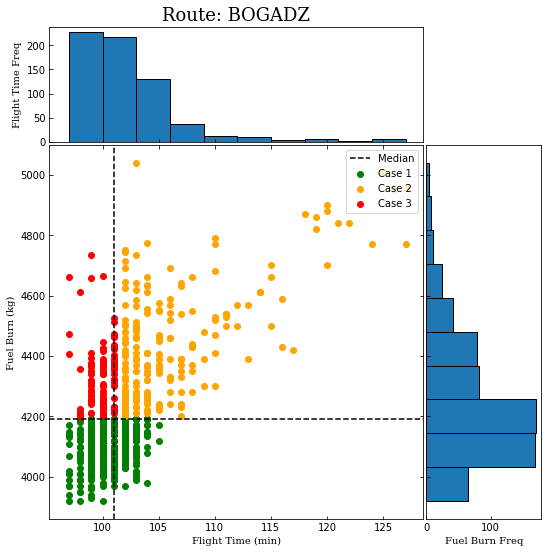

<Figure size 432x288 with 0 Axes>

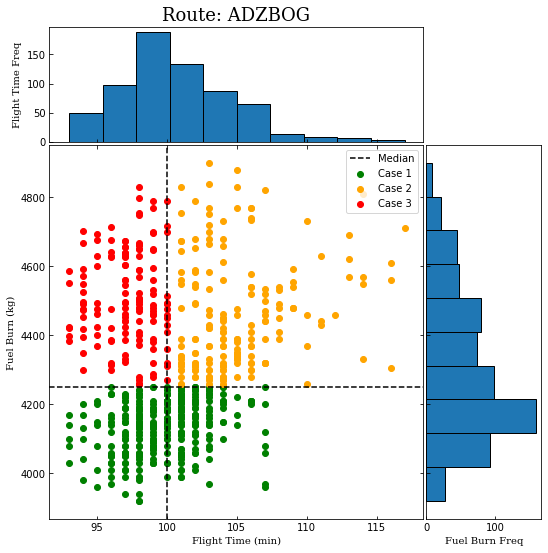

<Figure size 432x288 with 0 Axes>

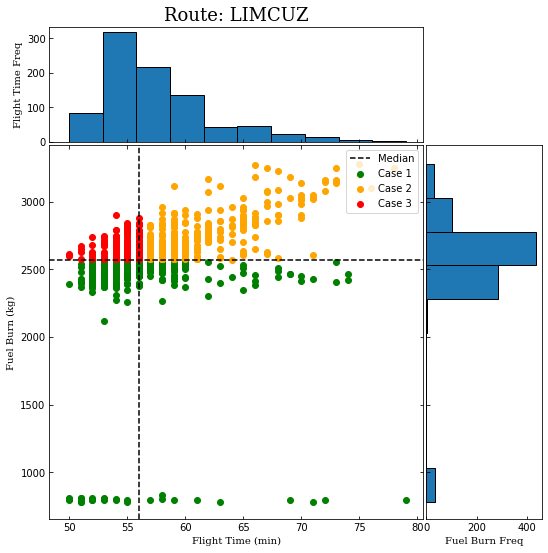

<Figure size 432x288 with 0 Axes>

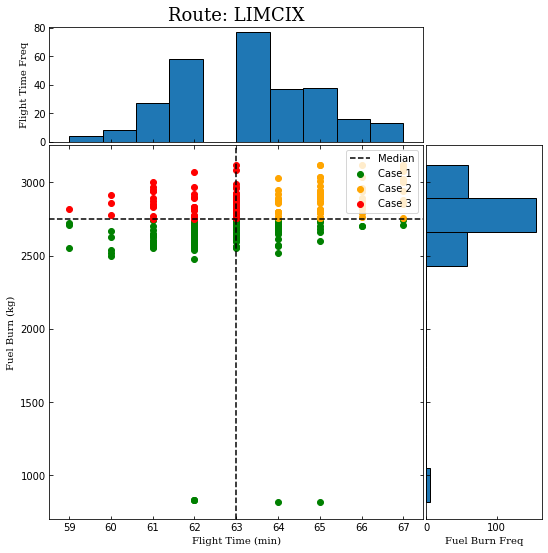

<Figure size 432x288 with 0 Axes>

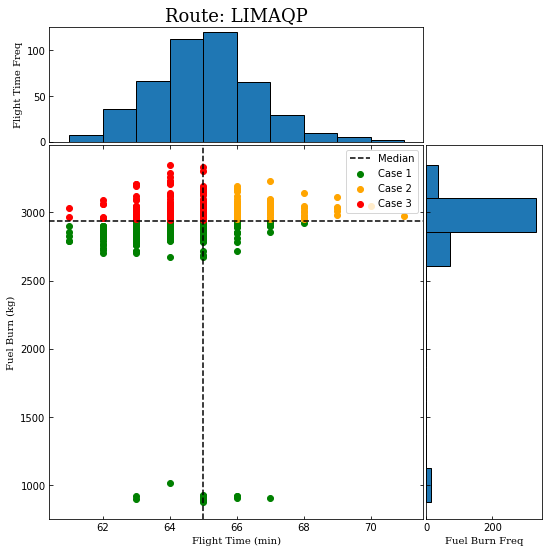

<Figure size 432x288 with 0 Axes>

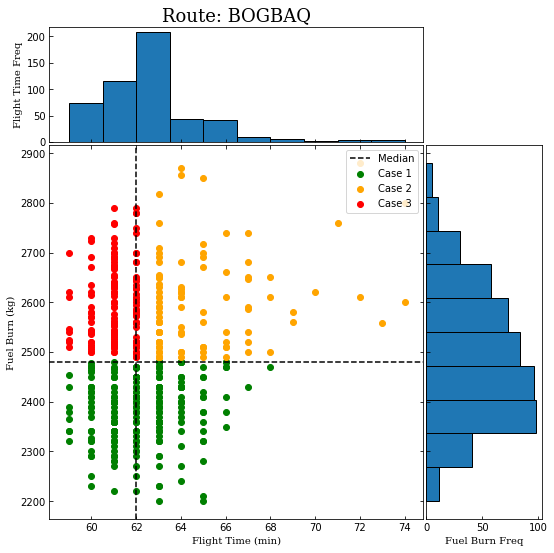

<Figure size 432x288 with 0 Axes>

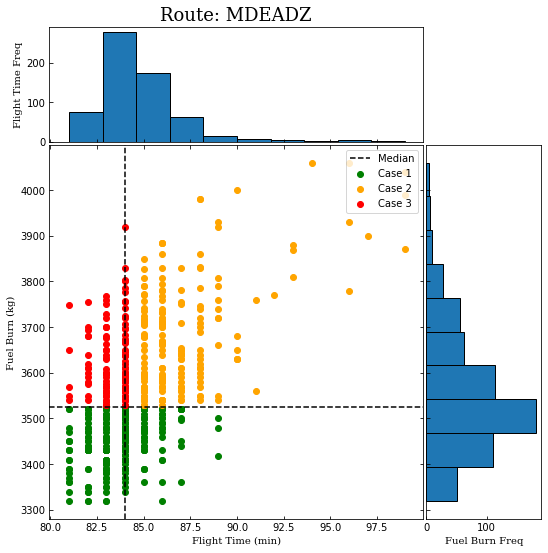

<Figure size 432x288 with 0 Axes>

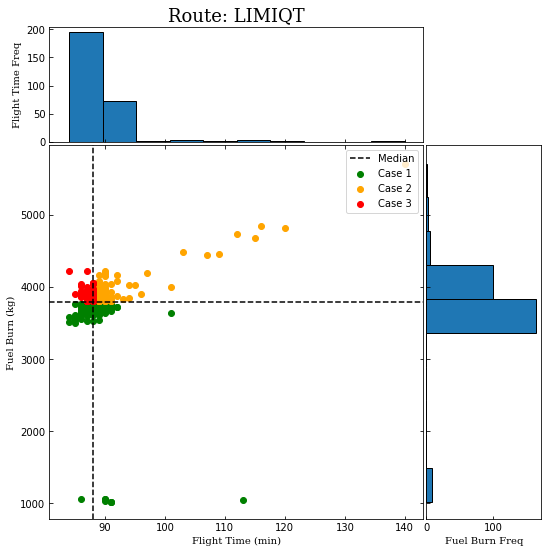

<Figure size 432x288 with 0 Axes>

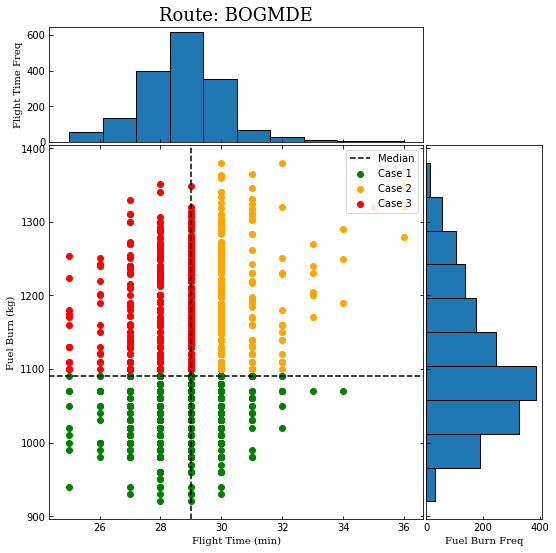

<Figure size 432x288 with 0 Axes>

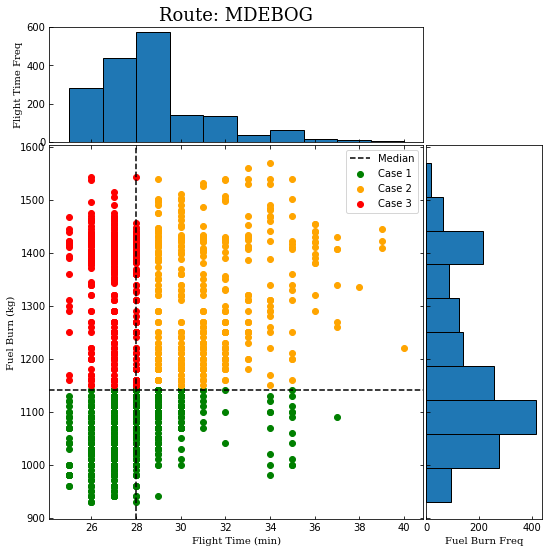

<Figure size 432x288 with 0 Axes>

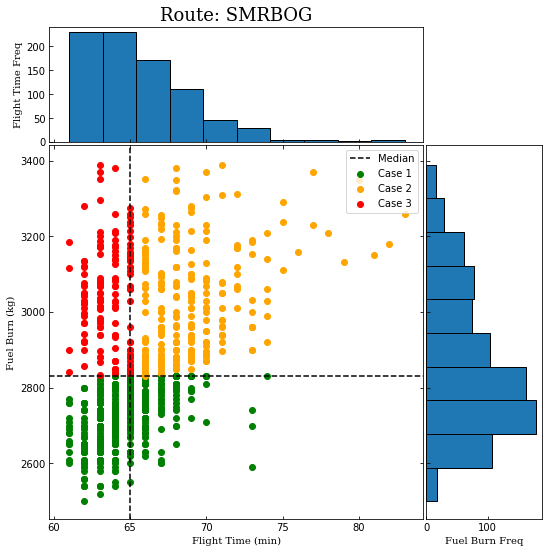

<Figure size 432x288 with 0 Axes>

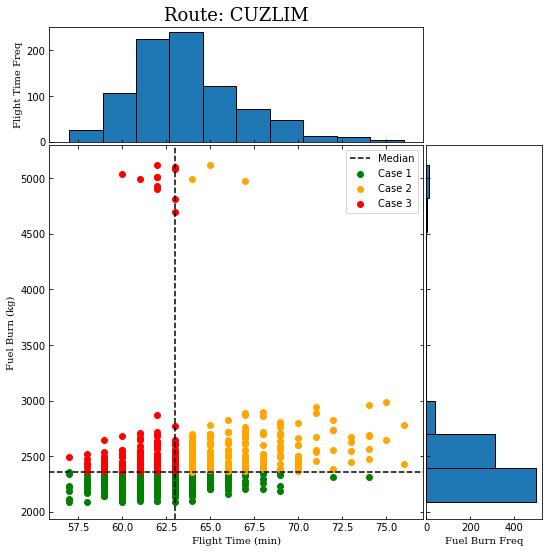

<Figure size 432x288 with 0 Axes>

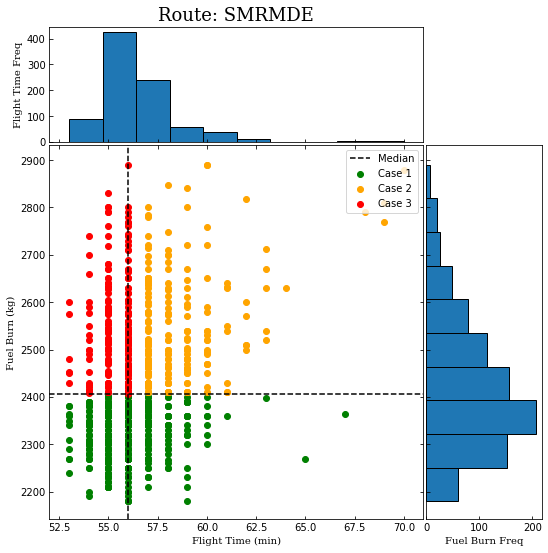

<Figure size 432x288 with 0 Axes>

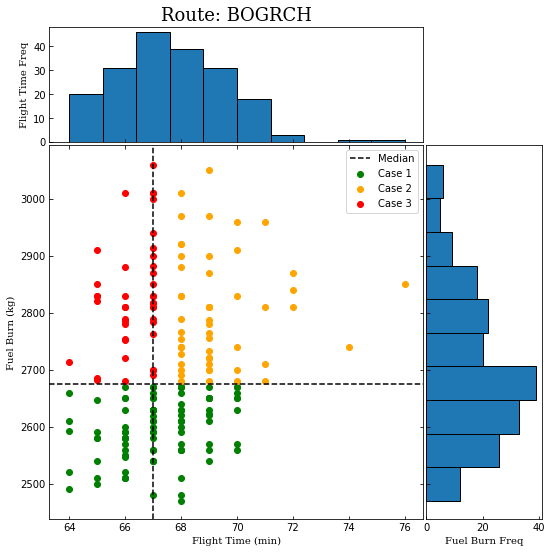

<Figure size 432x288 with 0 Axes>

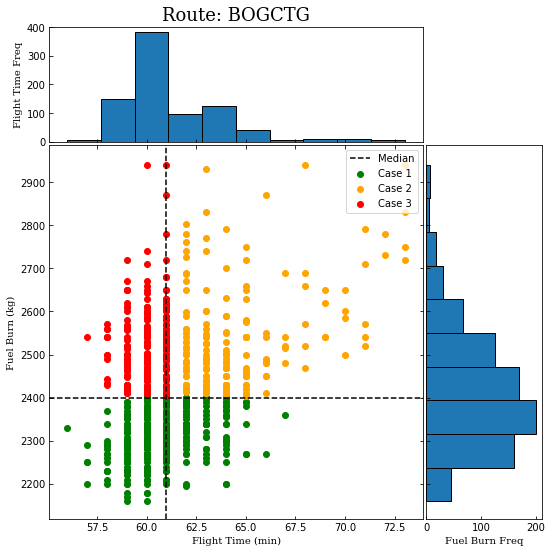

<Figure size 432x288 with 0 Axes>

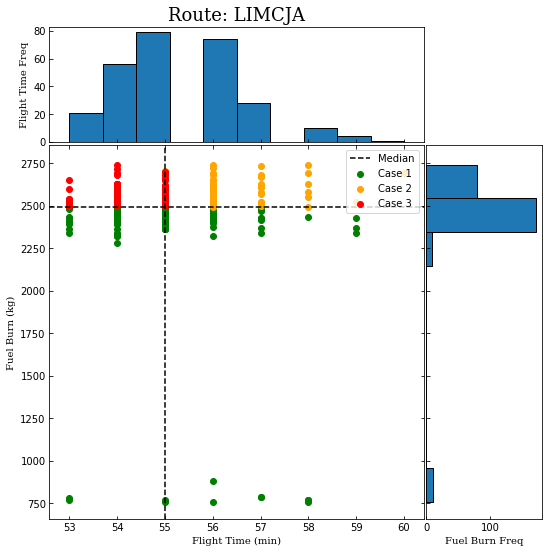

<Figure size 432x288 with 0 Axes>

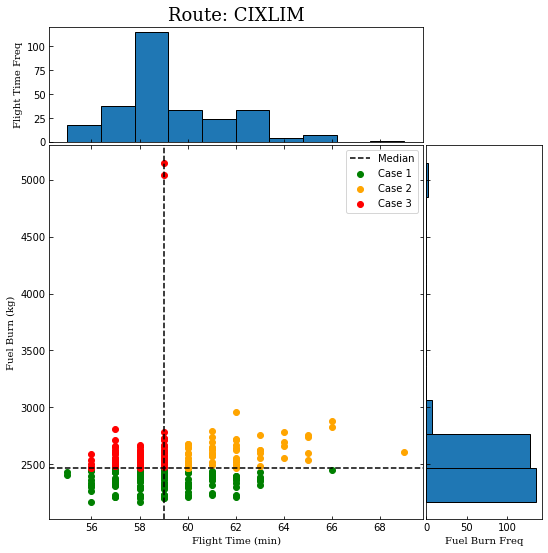

<Figure size 432x288 with 0 Axes>

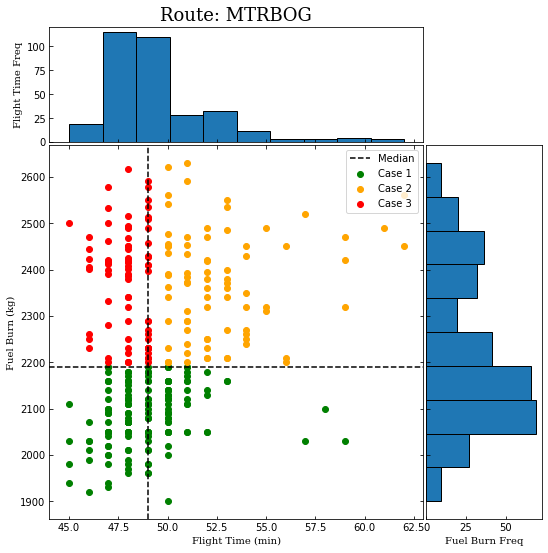

<Figure size 432x288 with 0 Axes>

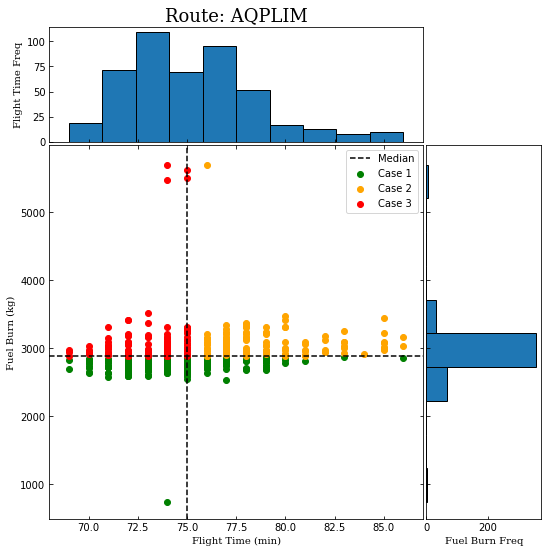

<Figure size 432x288 with 0 Axes>

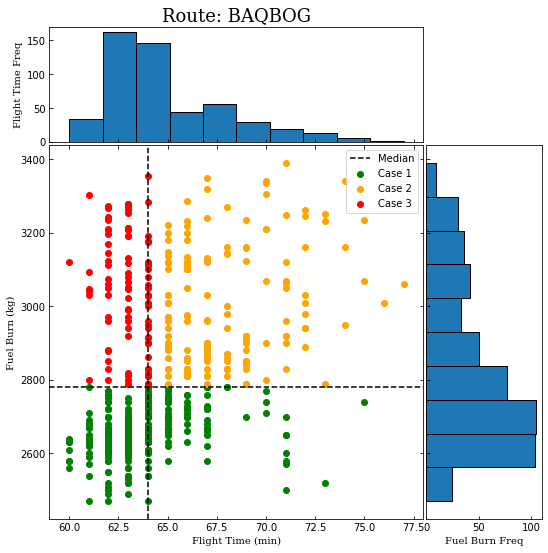

<Figure size 432x288 with 0 Axes>

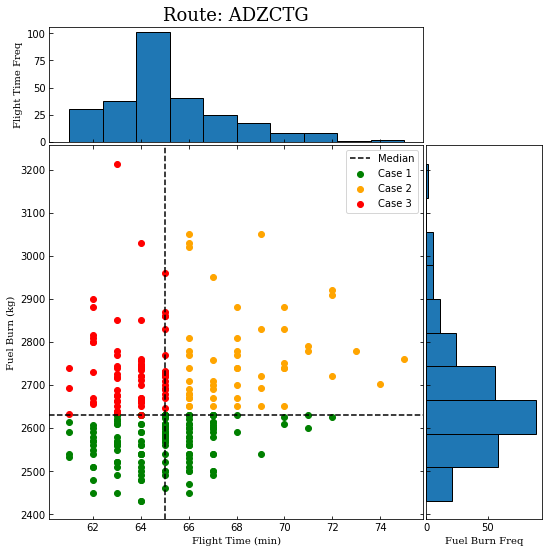

<Figure size 432x288 with 0 Axes>

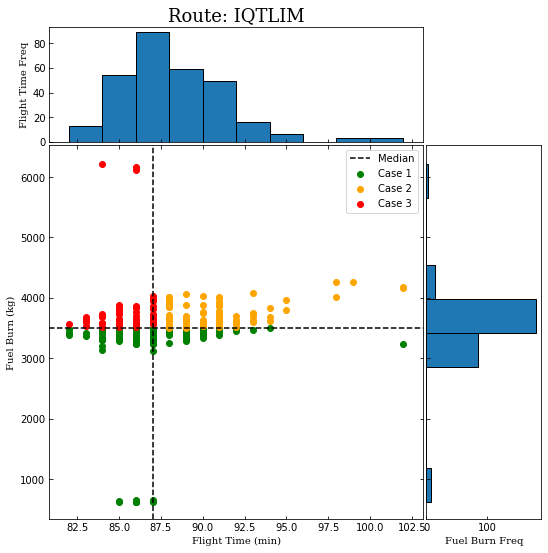

<Figure size 432x288 with 0 Axes>

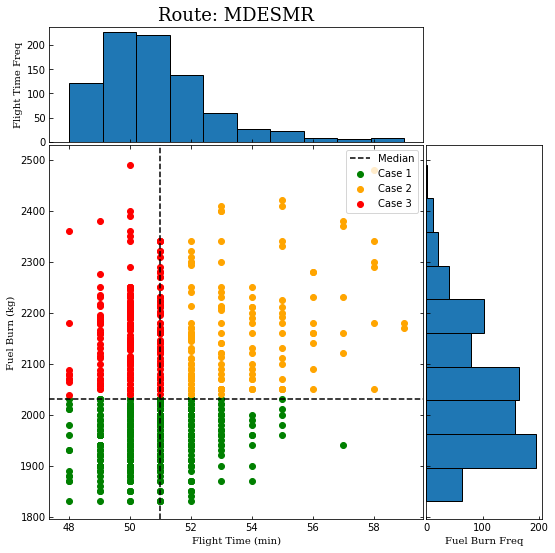

<Figure size 432x288 with 0 Axes>

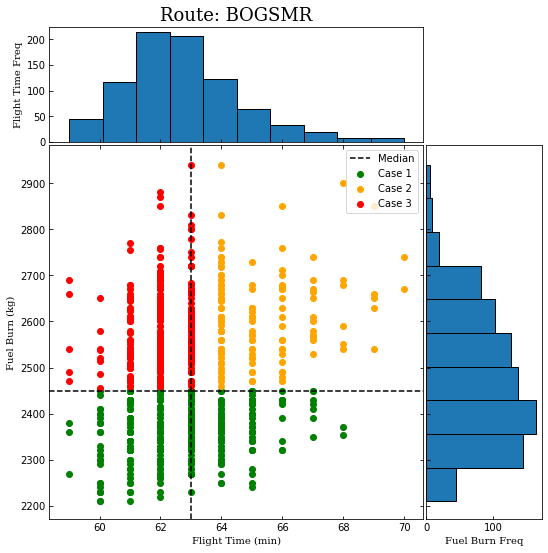

<Figure size 432x288 with 0 Axes>

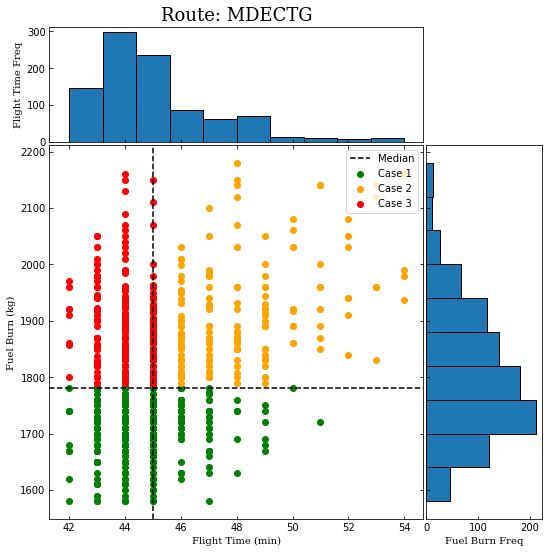

<Figure size 432x288 with 0 Axes>

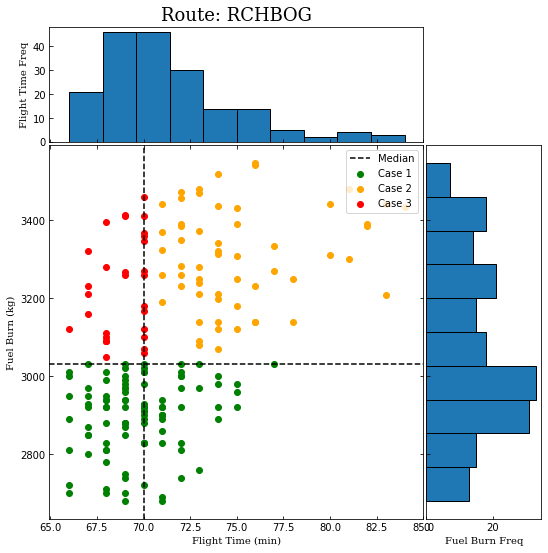

<Figure size 432x288 with 0 Axes>

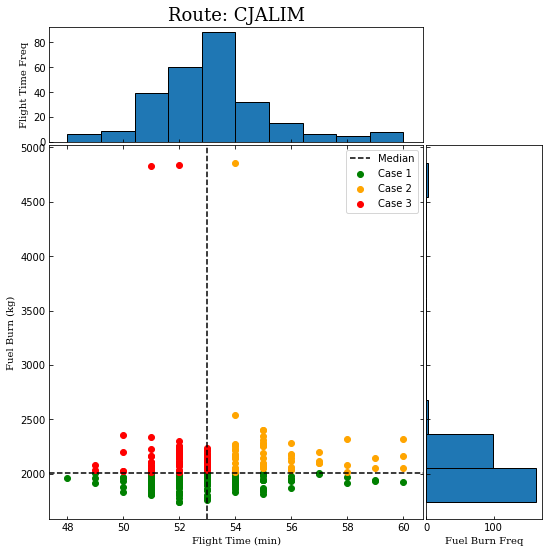

<Figure size 432x288 with 0 Axes>

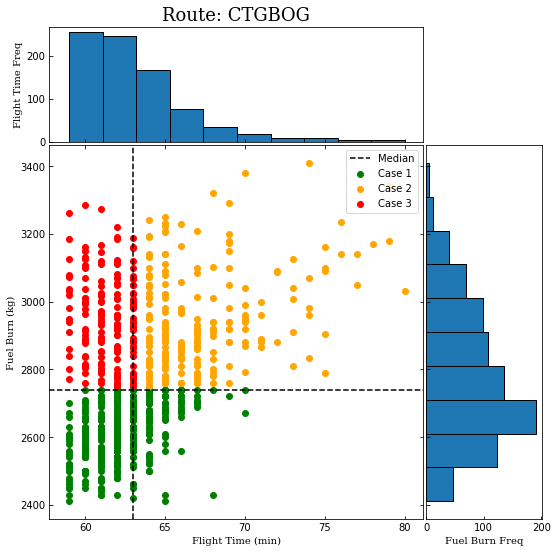

<Figure size 432x288 with 0 Axes>

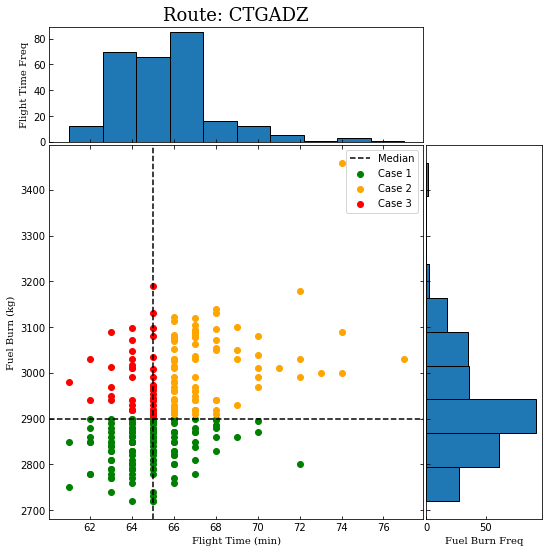

<Figure size 432x288 with 0 Axes>

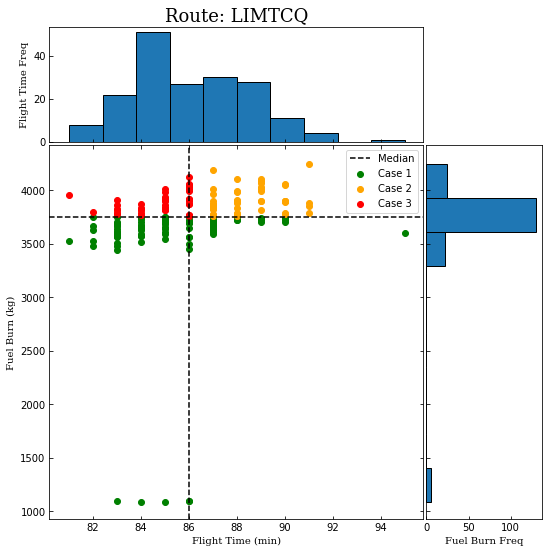

<Figure size 432x288 with 0 Axes>

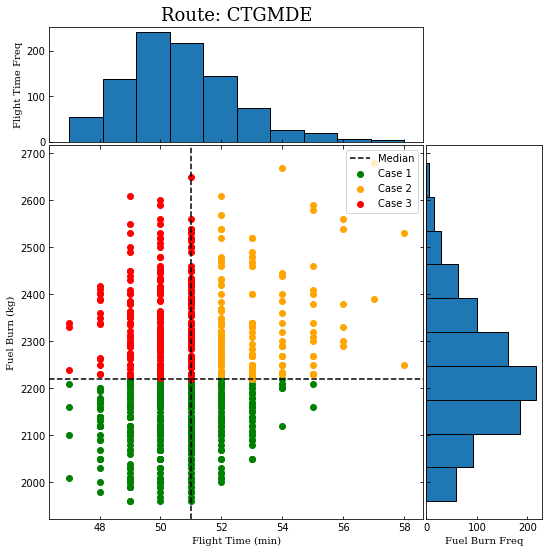

<Figure size 432x288 with 0 Axes>

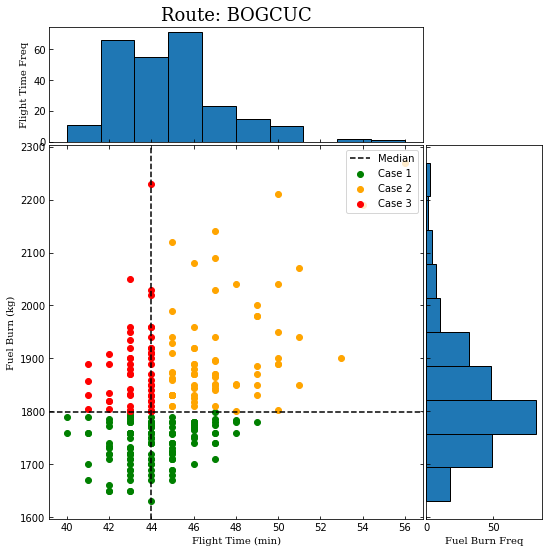

<Figure size 432x288 with 0 Axes>

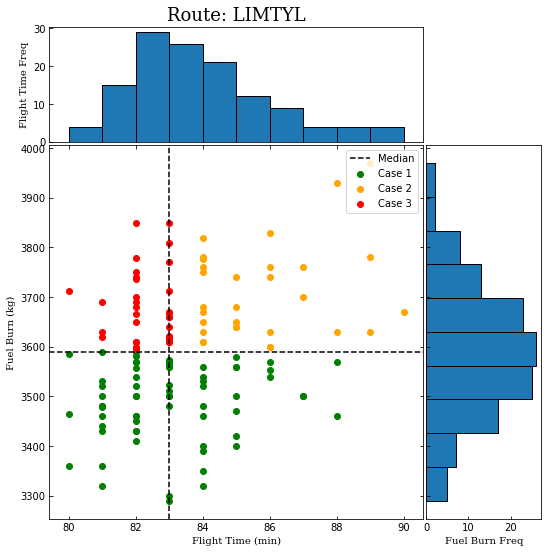

<Figure size 432x288 with 0 Axes>

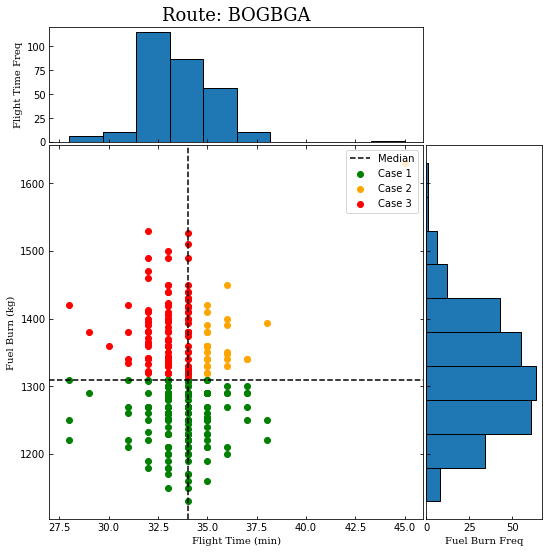

<Figure size 432x288 with 0 Axes>

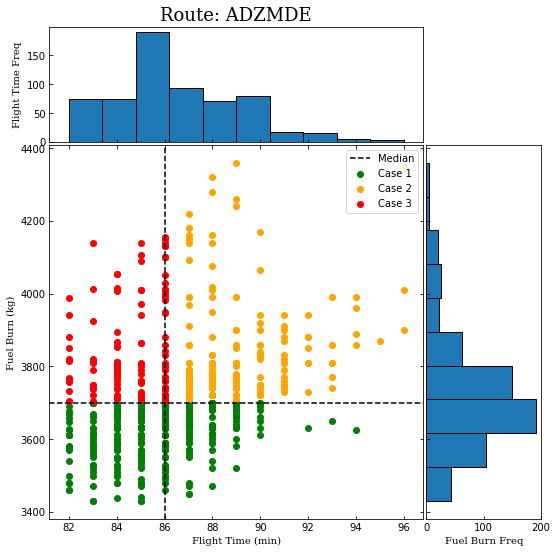

<Figure size 432x288 with 0 Axes>

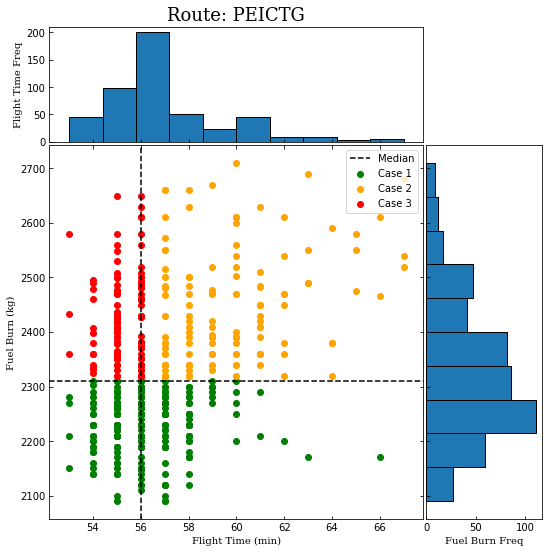

<Figure size 432x288 with 0 Axes>

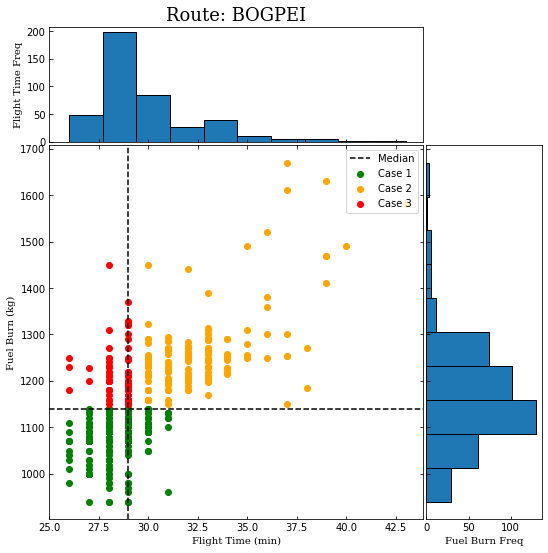

<Figure size 432x288 with 0 Axes>

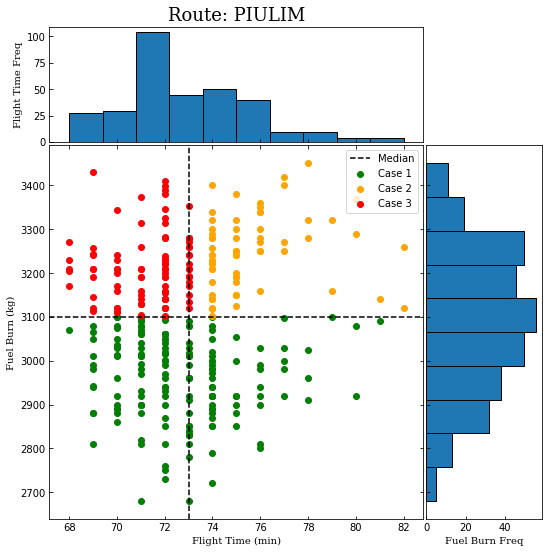

<Figure size 432x288 with 0 Axes>

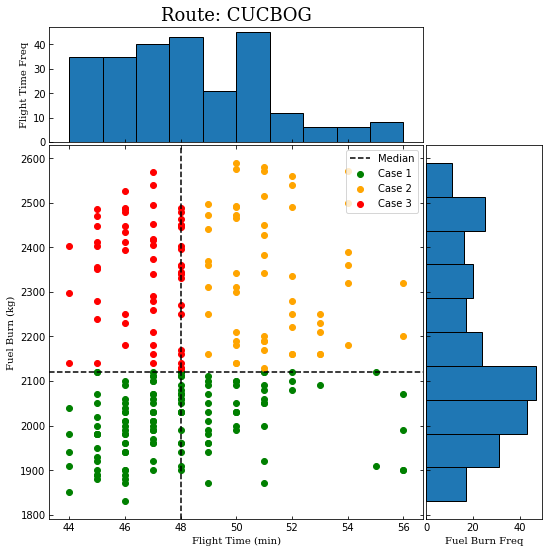

<Figure size 432x288 with 0 Axes>

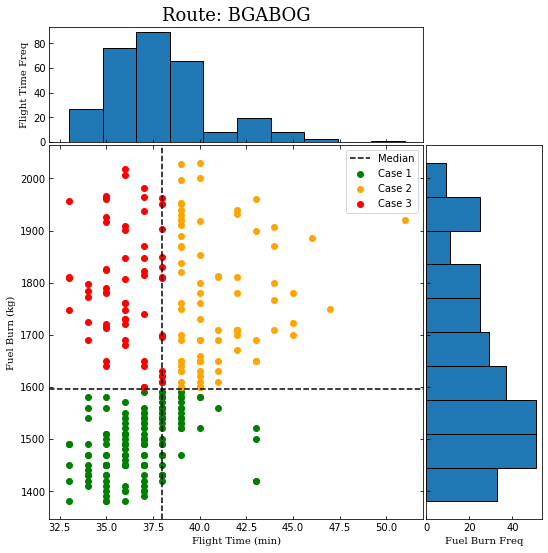

<Figure size 432x288 with 0 Axes>

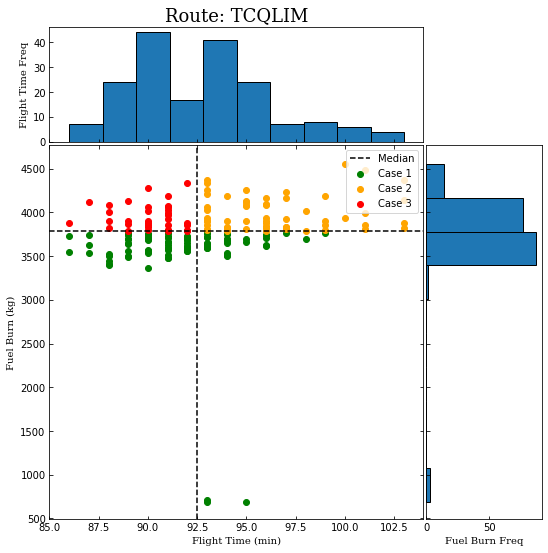

<Figure size 432x288 with 0 Axes>

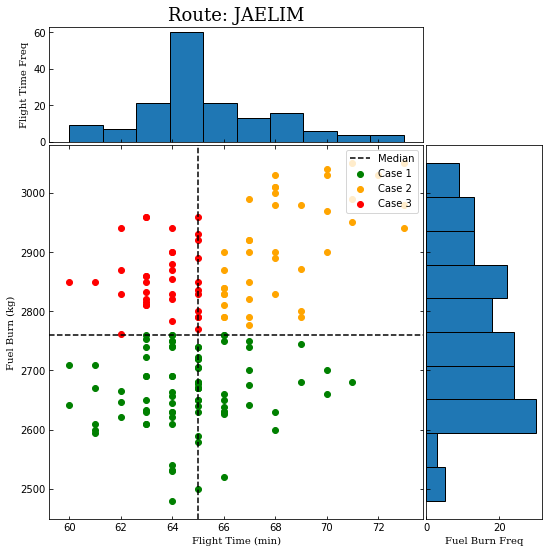

<Figure size 432x288 with 0 Axes>

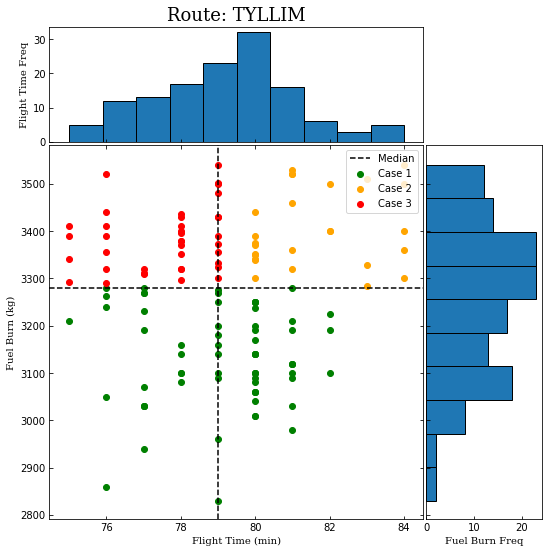

<Figure size 432x288 with 0 Axes>

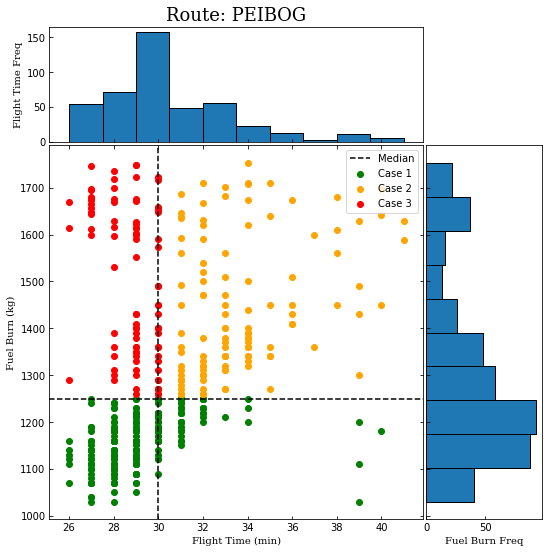

<Figure size 432x288 with 0 Axes>

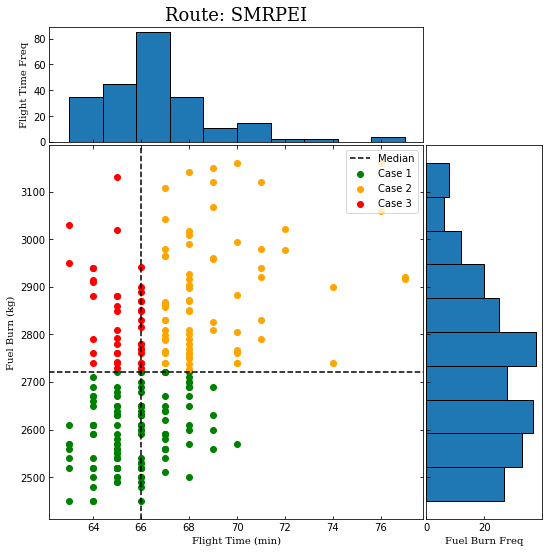

<Figure size 432x288 with 0 Axes>

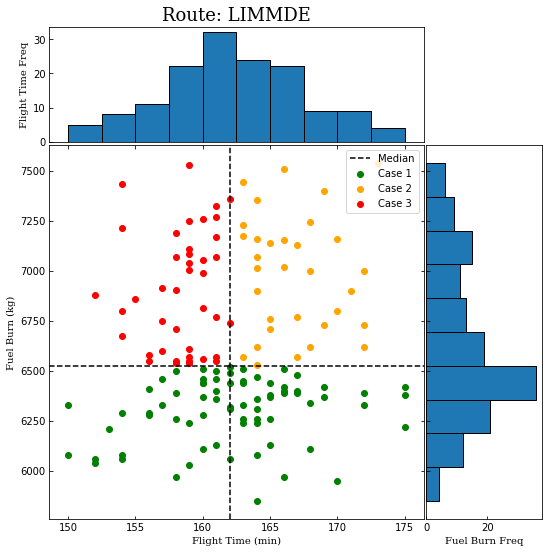

<Figure size 432x288 with 0 Axes>

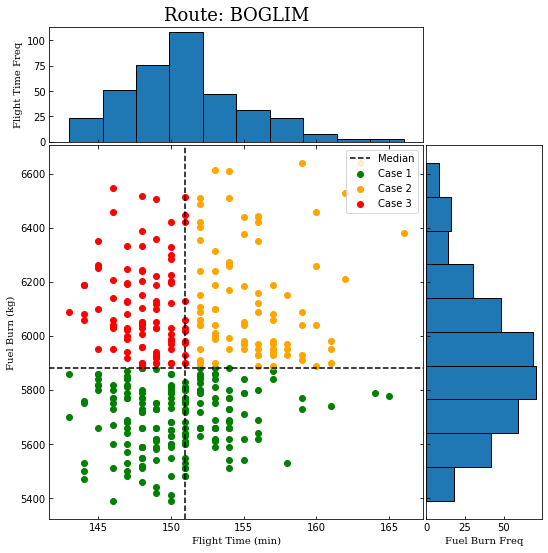

<Figure size 432x288 with 0 Axes>

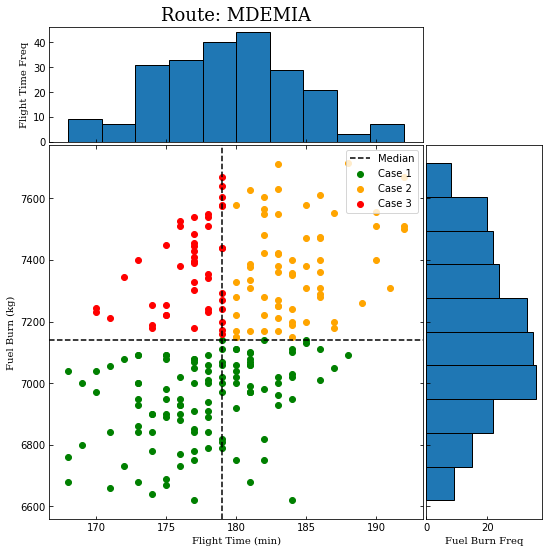

<Figure size 432x288 with 0 Axes>

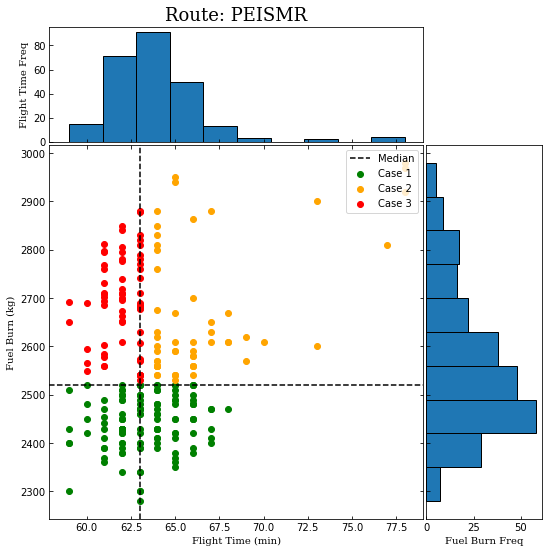

<Figure size 432x288 with 0 Axes>

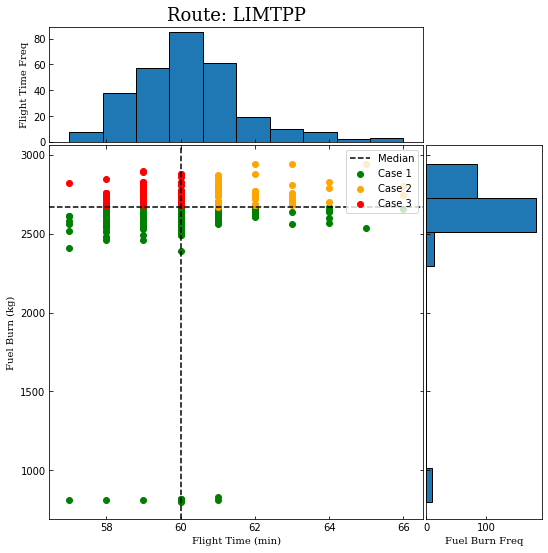

<Figure size 432x288 with 0 Axes>

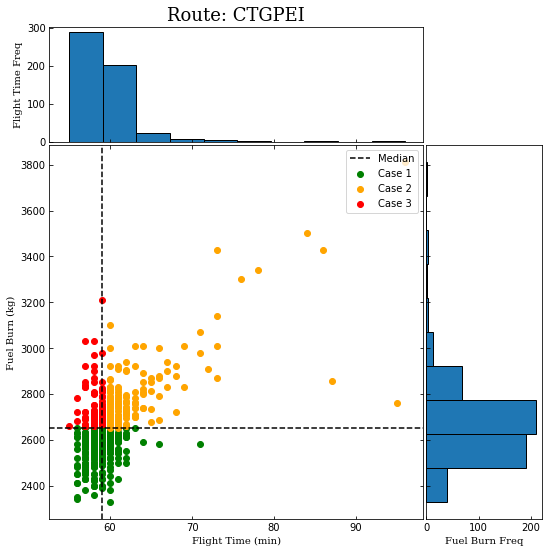

<Figure size 432x288 with 0 Axes>

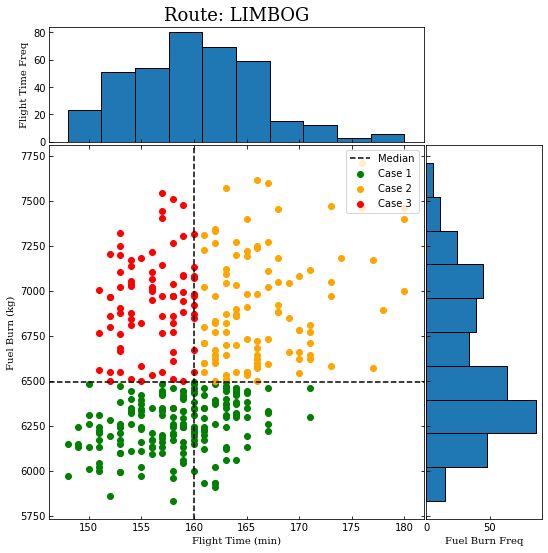

<Figure size 432x288 with 0 Axes>

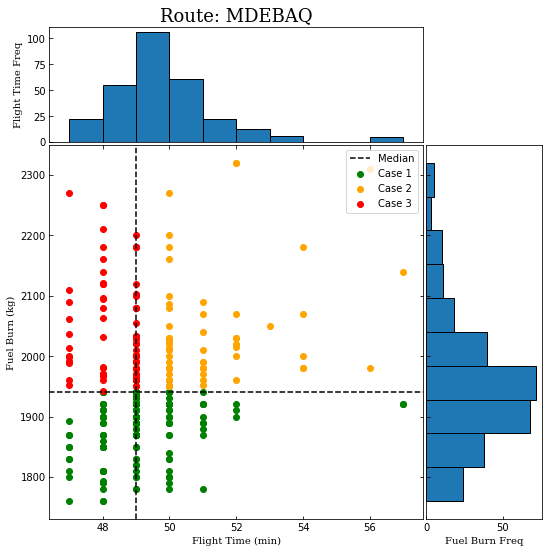

<Figure size 432x288 with 0 Axes>

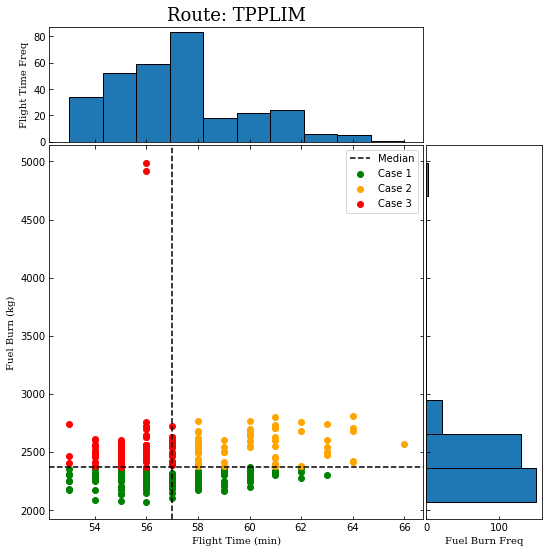

<Figure size 432x288 with 0 Axes>

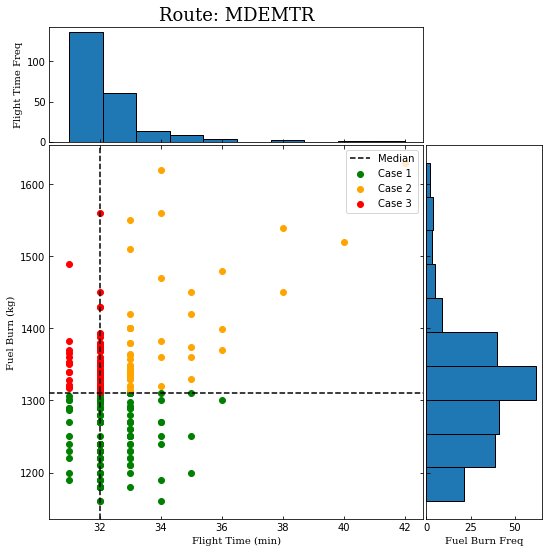

<Figure size 432x288 with 0 Axes>

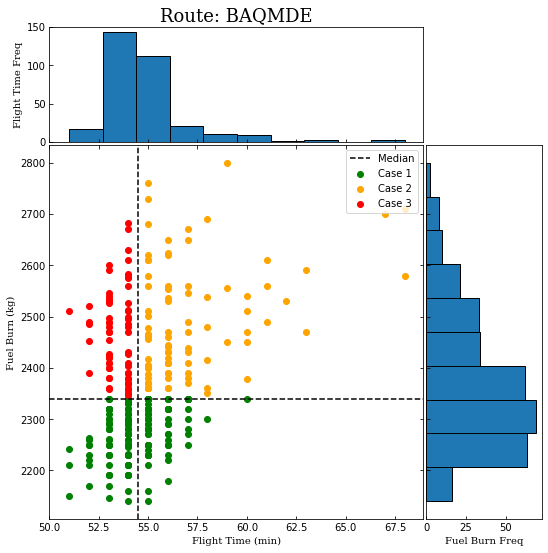

<Figure size 432x288 with 0 Axes>

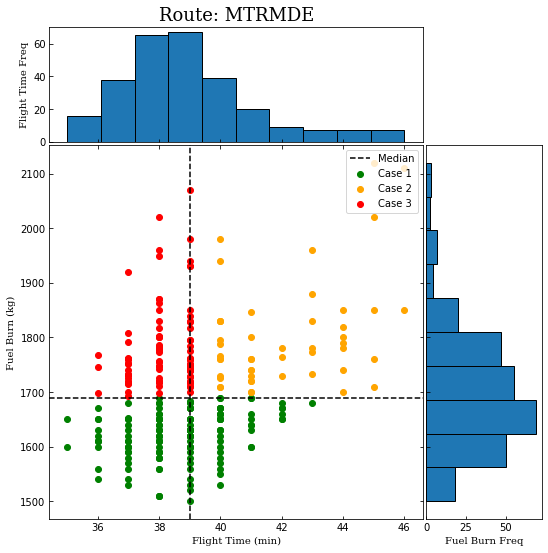

<Figure size 432x288 with 0 Axes>

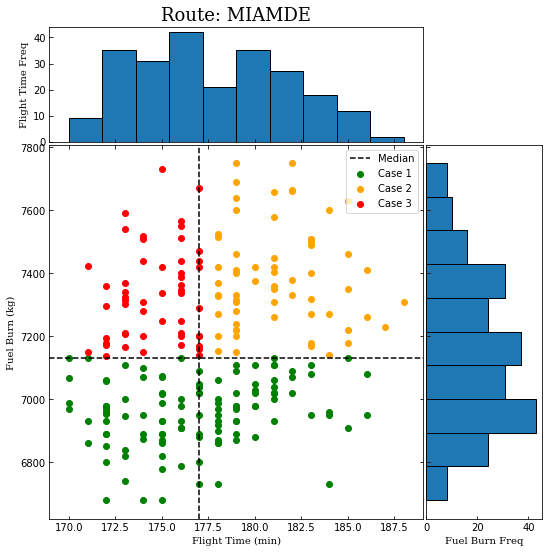

<Figure size 432x288 with 0 Axes>

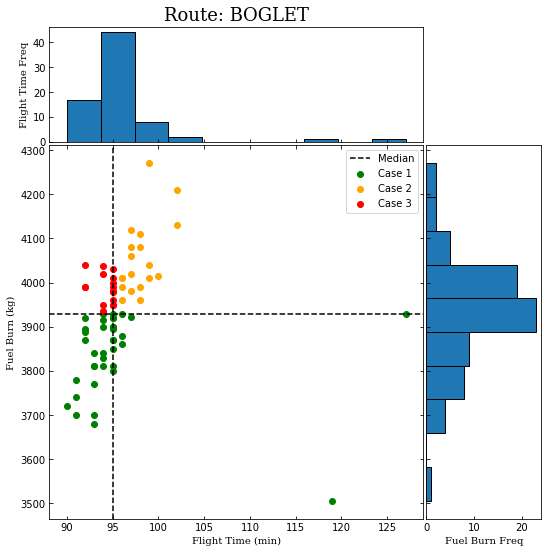

<Figure size 432x288 with 0 Axes>

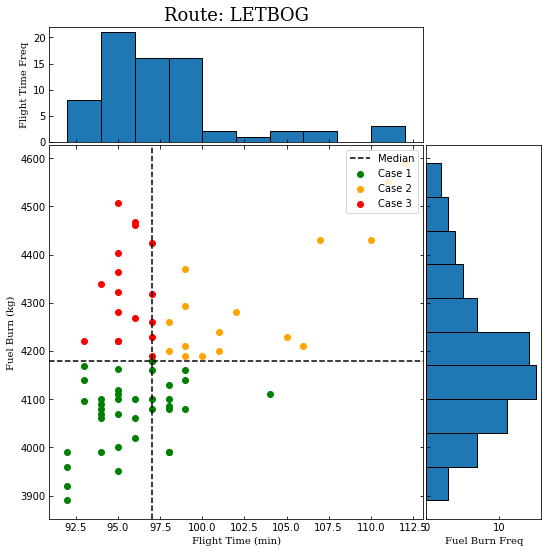

<Figure size 432x288 with 0 Axes>

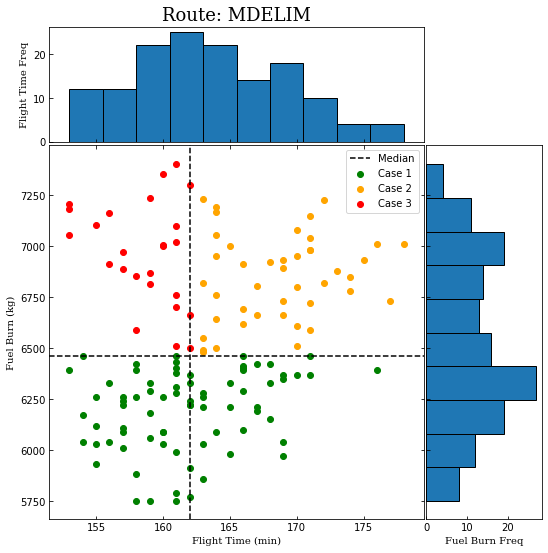

<Figure size 432x288 with 0 Axes>

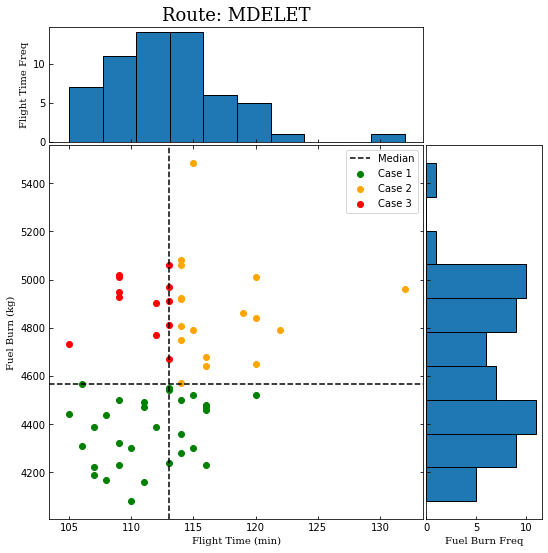

<Figure size 432x288 with 0 Axes>

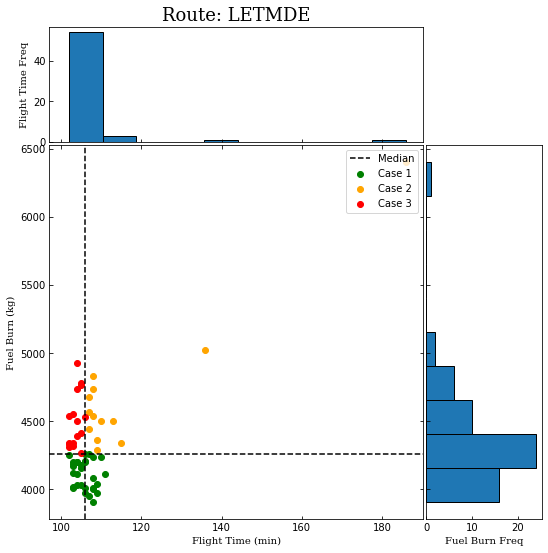

<Figure size 432x288 with 0 Axes>

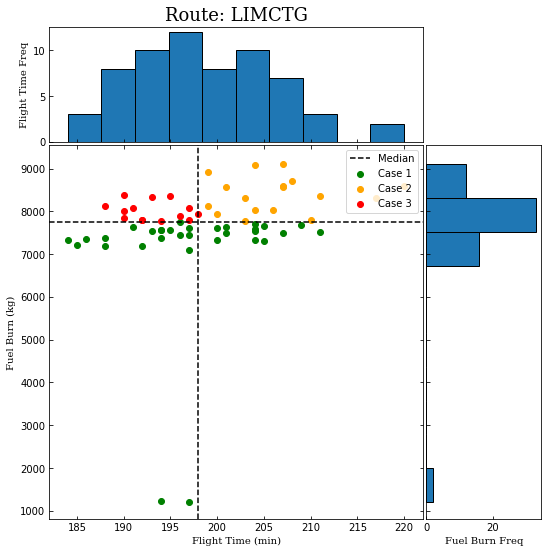

<Figure size 432x288 with 0 Axes>

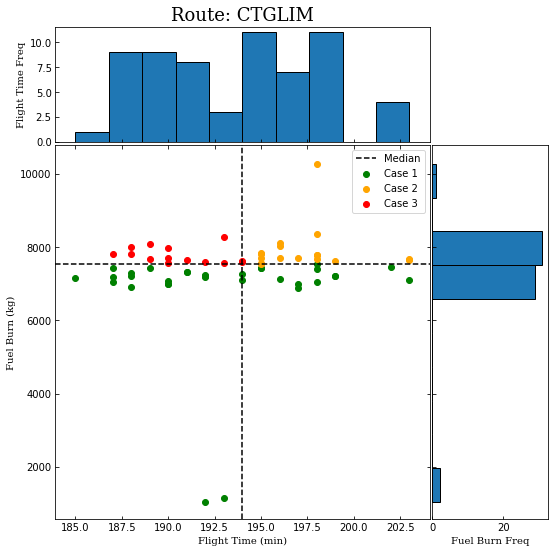

<Figure size 432x288 with 0 Axes>

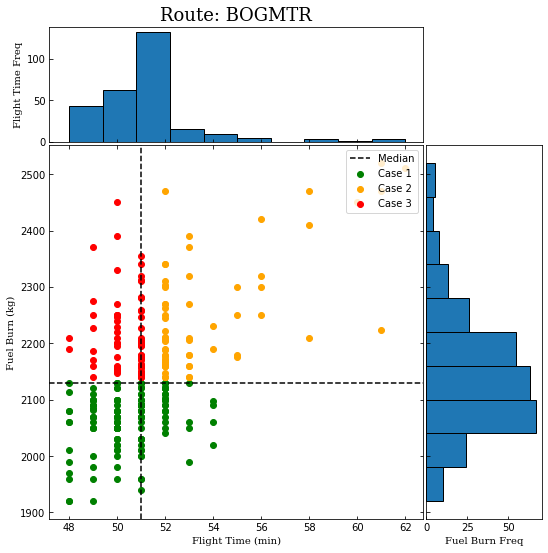

<Figure size 432x288 with 0 Axes>

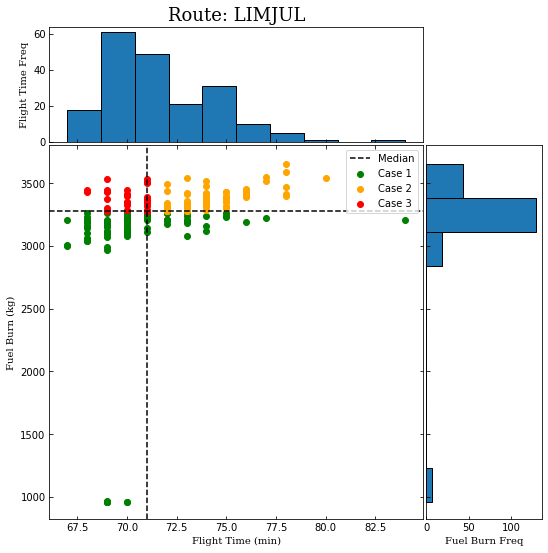

<Figure size 432x288 with 0 Axes>

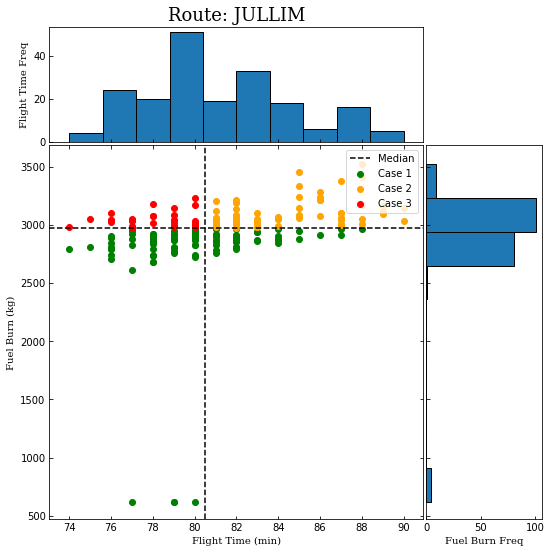

<Figure size 432x288 with 0 Axes>

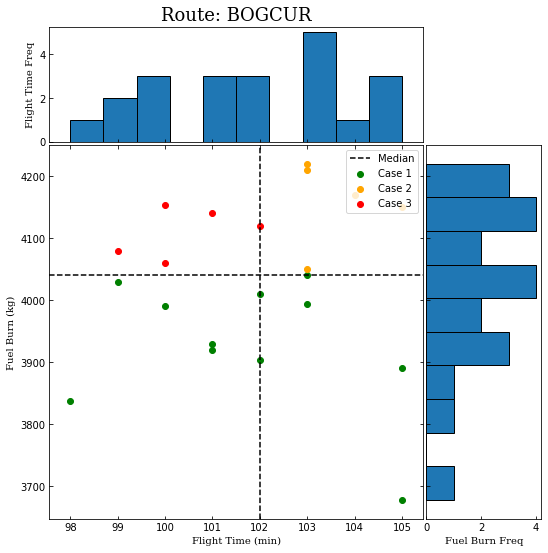

<Figure size 432x288 with 0 Axes>

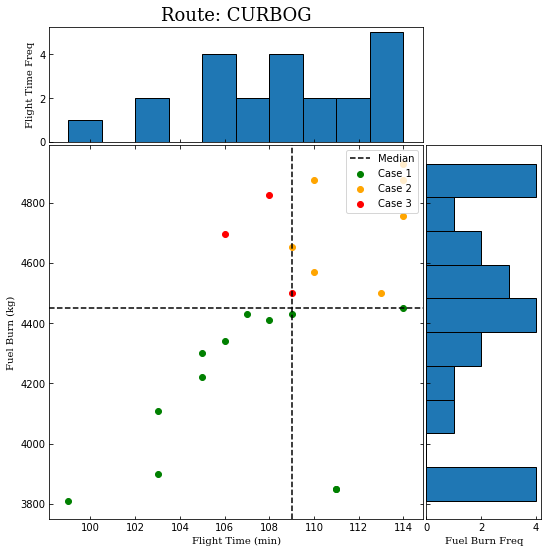

<Figure size 432x288 with 0 Axes>

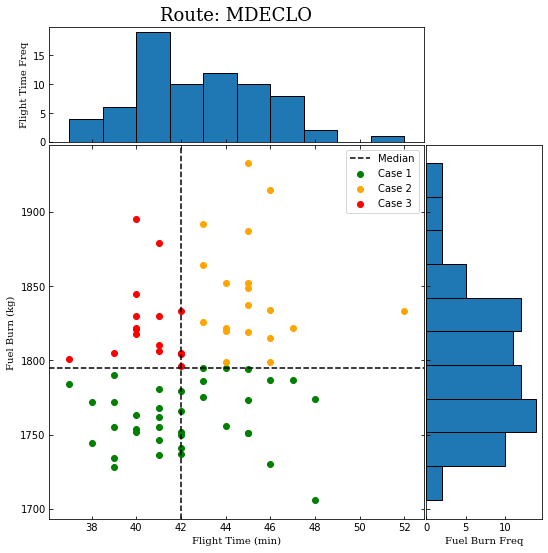

<Figure size 432x288 with 0 Axes>

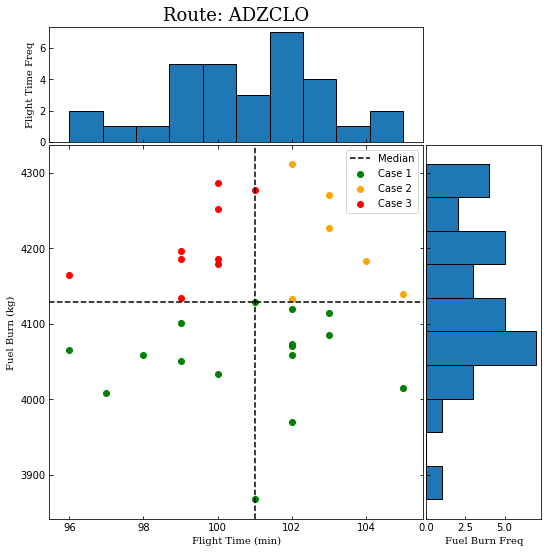

<Figure size 432x288 with 0 Axes>

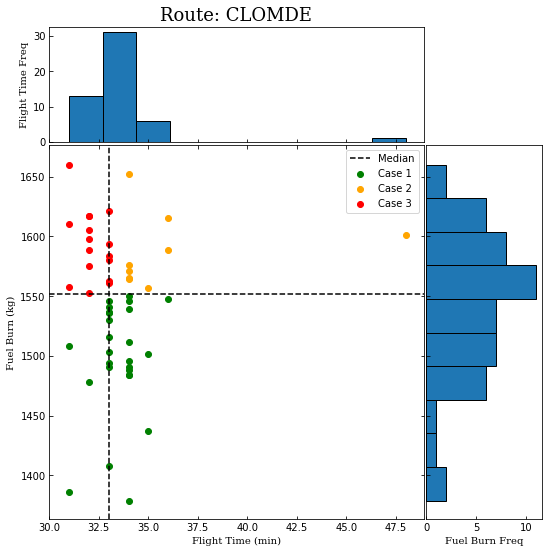

<Figure size 432x288 with 0 Axes>

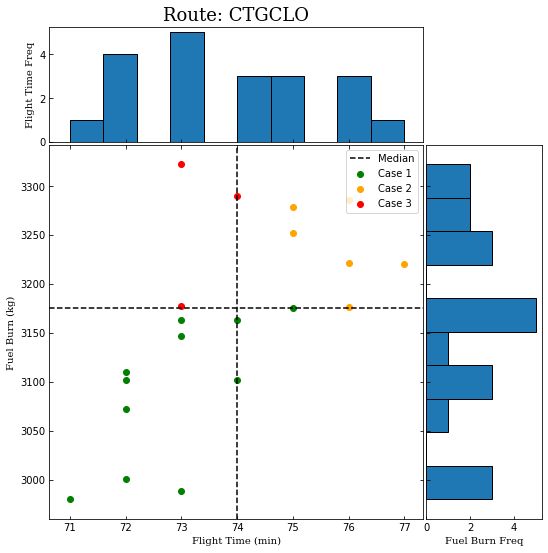

<Figure size 432x288 with 0 Axes>

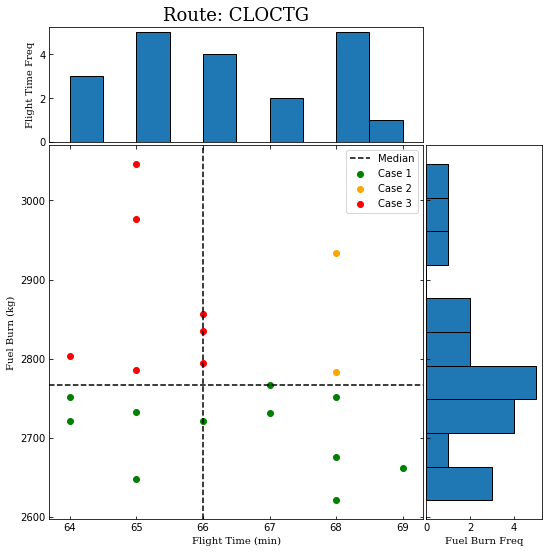

<Figure size 432x288 with 0 Axes>

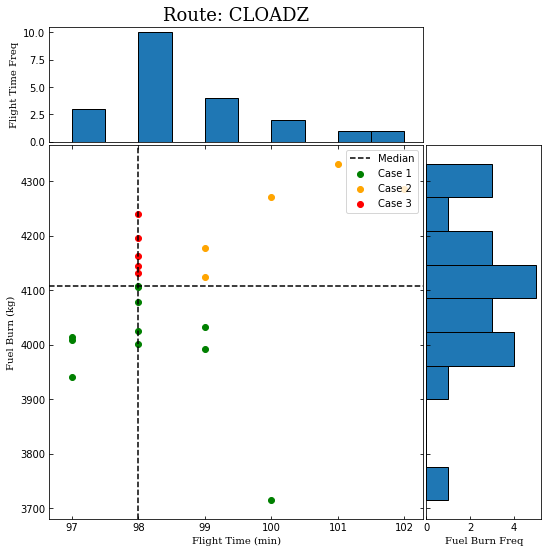

<Figure size 432x288 with 0 Axes>

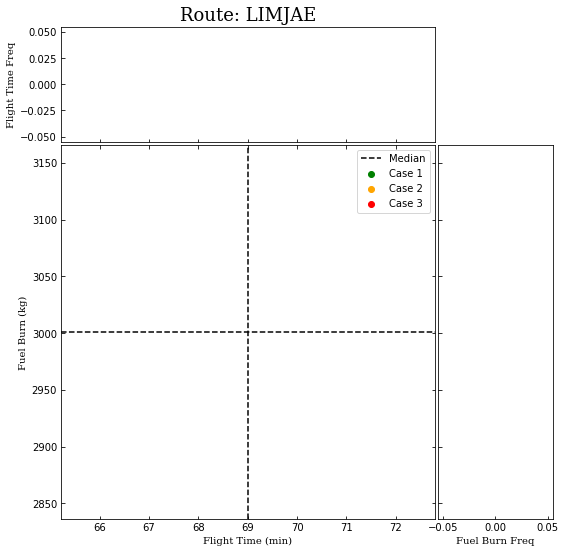

In [34]:
for i in Master['Leg'].unique():
    MultivarGraph(i) 

In [37]:
def GraphVars(Test='All',Var="V Vsby",Target='Fuel Burn'):
    fig = plt.figure(figsize=(10,8))
    
    if Var=="V Vsby":
        xlab='Vertical Visibility (ft)'
    elif Var=="H Vsby":
        xlab='Horizontal Visibility (miles)'
    else:
        xlab=Var
        
    if Test=="All":
        x=Master[Var]
        y=Master[Target]
        plt.title(Target+" vs. "+xlab+": All Routes",family='serif',size=18)
    else:

        x=Master[Master['D']==Test][Var]
        y=Master[Master['D']==Test][Target]
        plt.title(Target+" vs. "+xlab+": "+Test,family='serif',size=18)
    
    plt.xlabel(xlab,family='serif',size=12)
    
    plt.scatter(x,y,color='red')
    plt.ylabel(Target+' (kg)',family='serif',size=12)
    
    my_file=Target+" vs "+xlab+" "+Test+'.png'
    dir2=os.getcwd()+"/Scatter  Plots/"+Test 
    plt.savefig(os.path.join(dir2, my_file))
    
    
    

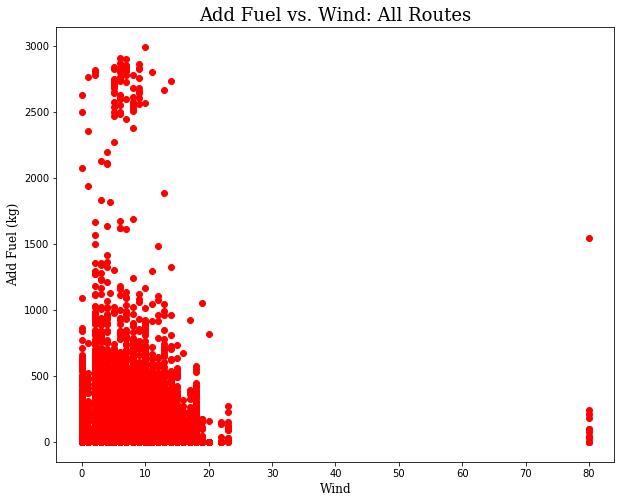

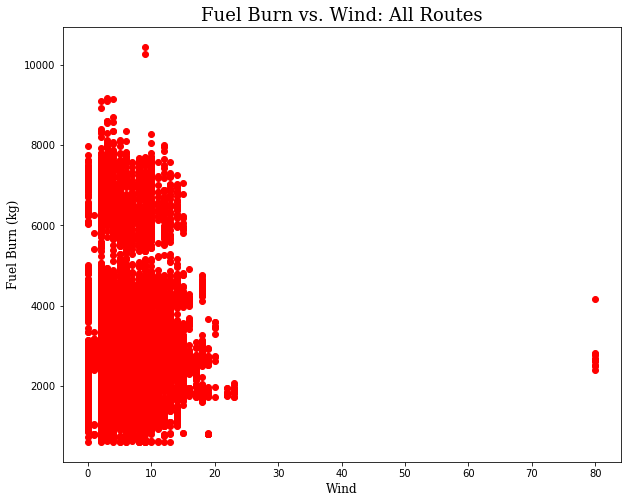

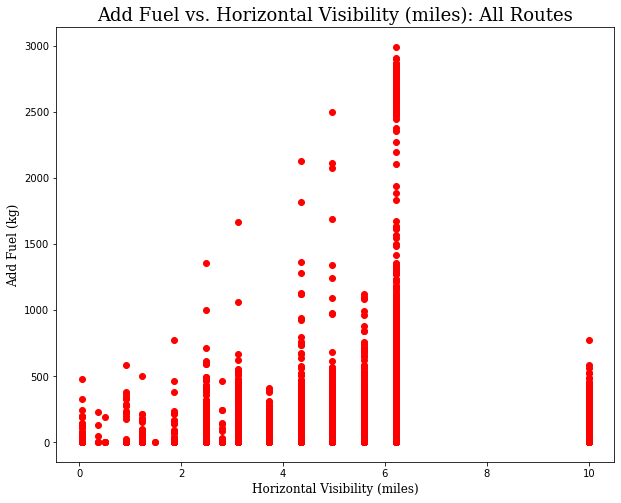

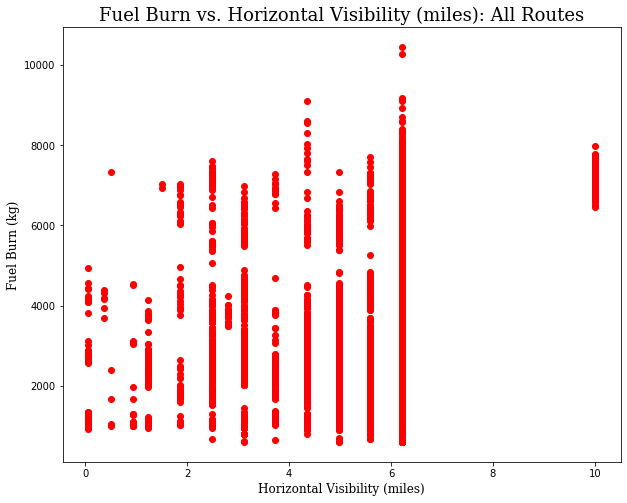

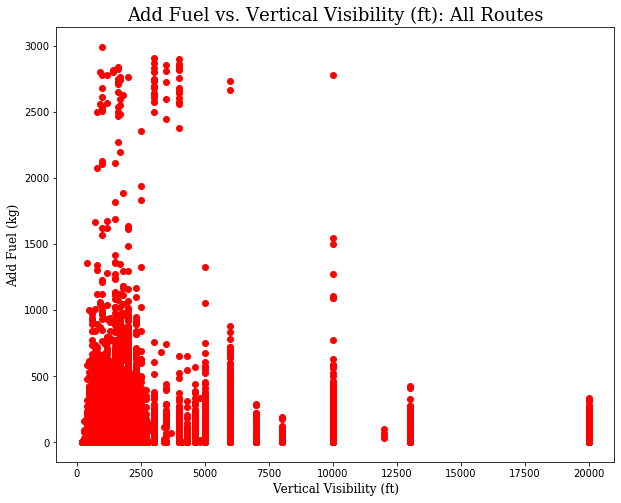

...

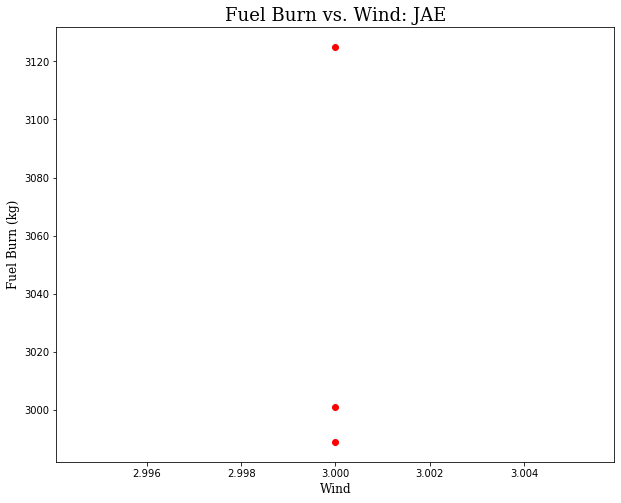

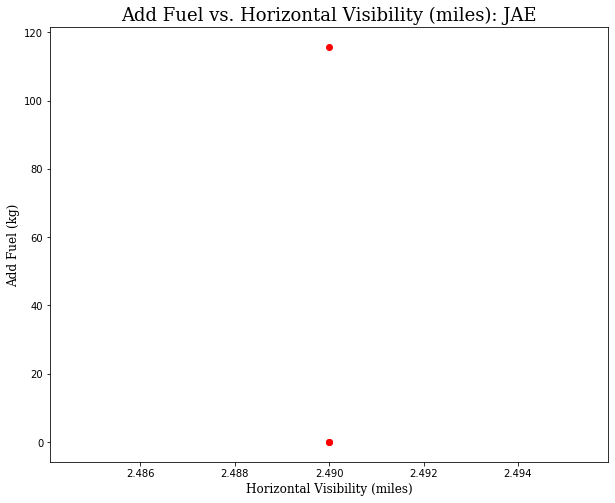

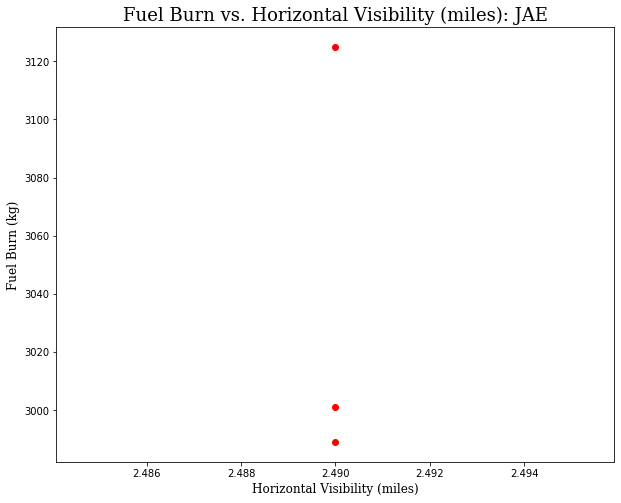

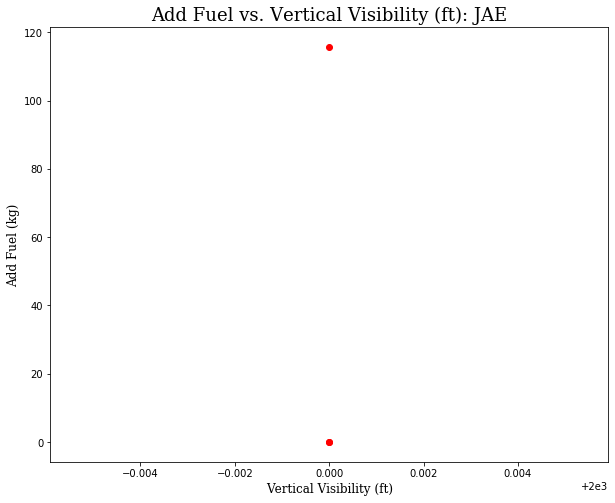

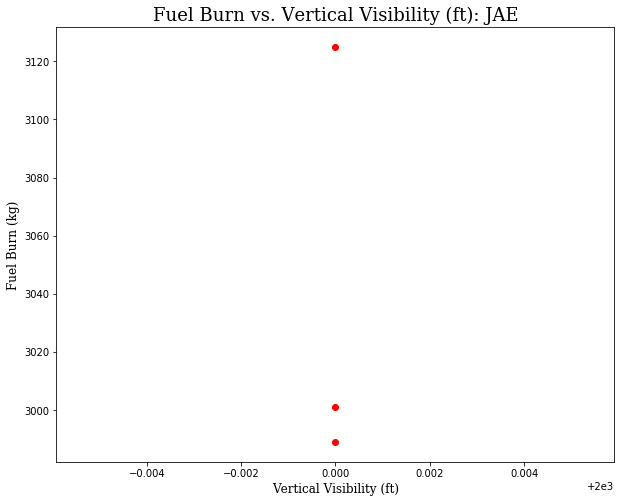

In [36]:
Target=['Add Fuel','Fuel Burn']
Vars=['Wind','H Vsby','V Vsby']
Test=['All']+list(Master['D'].unique())

for k in Test:
    dir2 = os.getcwd()+"/Scatter  Plots/"+k
    if os.path.exists(dir2):
        shutil.rmtree(dir2)
    os.makedirs(dir2)
    
    for j in Vars:
        for i in Target:
            GraphVars(Test=k,Var=j,Target=i)
                

In [59]:
from mpl_toolkits.mplot3d import axes3d, Axes3D

def ThirdGraph(Test='All',Target='Fuel Burn'):
    fig = plt.figure(figsize=(12, 12))
    ax = fig.gca(projection='3d')
    
    if Test=='All':
        y=Master['V Vsby']
        x=Master['H Vsby']
        z=Master[Target]
    else:
        y=Master[Master['D']==Test]['V Vsby']
        x=Master[Master['D']==Test]['H Vsby']
        z=Master[Master['D']==Test][Target]

    ax.set_ylabel('Vertical Visibility (ft)',family='serif',size=12)
    ax.set_xlabel('Horizontal Visibility (miles)',family='serif',size=12)
    ax.set_zlabel(Target+" (kg)",family='serif',size=12)
    ax.set_title(Target+" Visibility Analysis "+Test,family='serif',size=18)
    
    ax.scatter(x,y,z)
    
    ax = plt.gca()
    #ax.set_xlim(ax.get_xlim()[::-1])
    #ax.set_ylim(ax.get_ylim()[::-1])
        
    my_file=Target+" Visibility Analysis "+Test+'.png'
    dir2=os.getcwd()+"/Scatter  Plots/"+Test 
    plt.savefig(os.path.join(dir2, my_file))
    
    dir=os.getcwd()+"/3D Graphs"
    plt.savefig(os.path.join(dir, my_file))

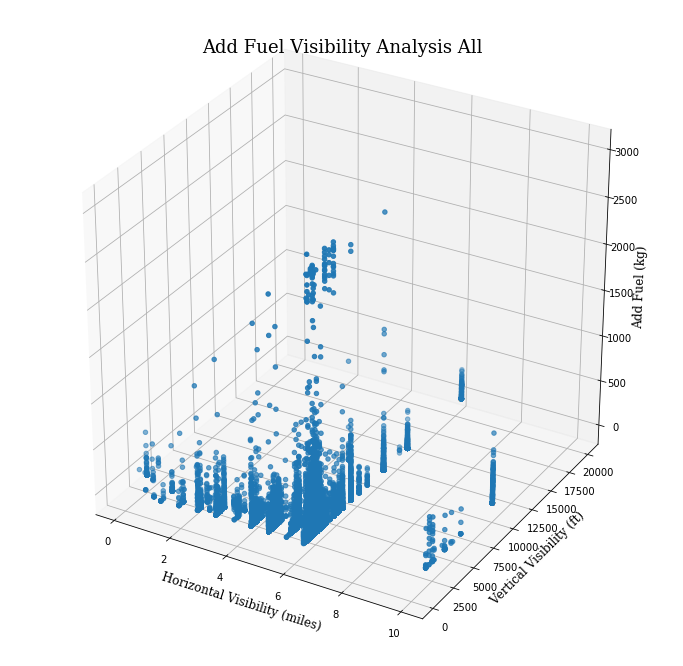

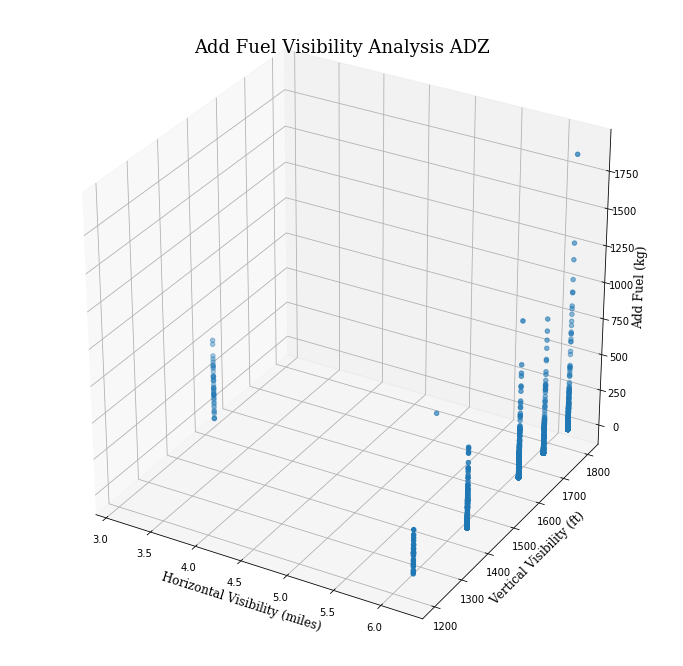

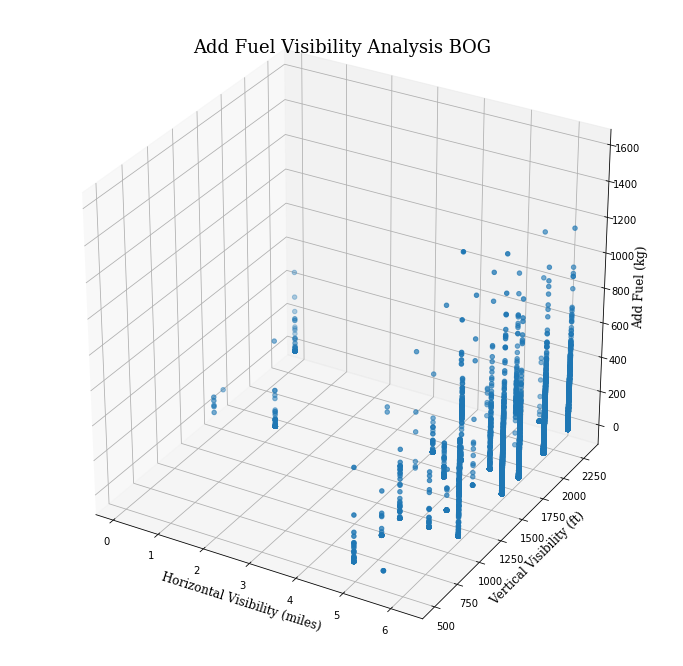

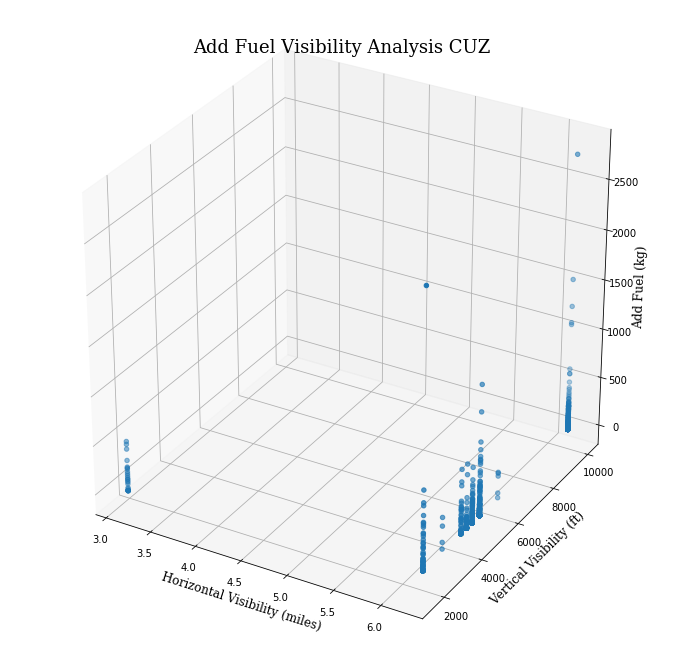

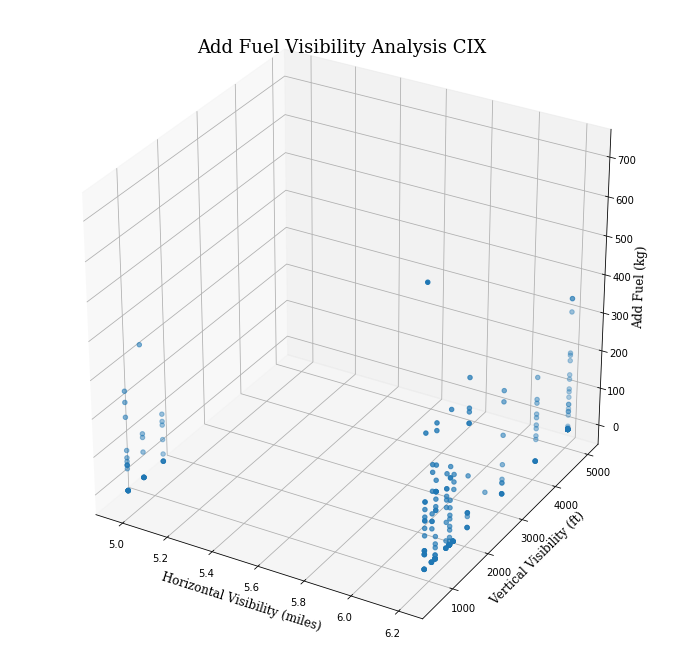

...

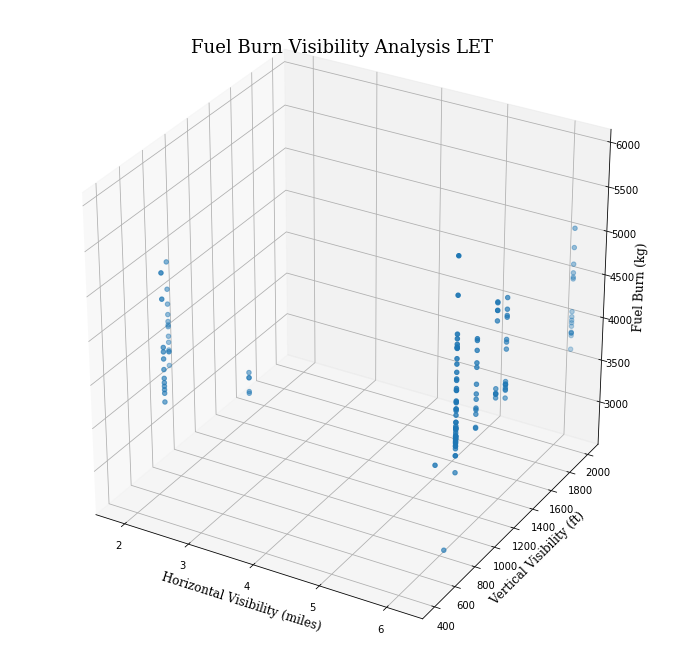

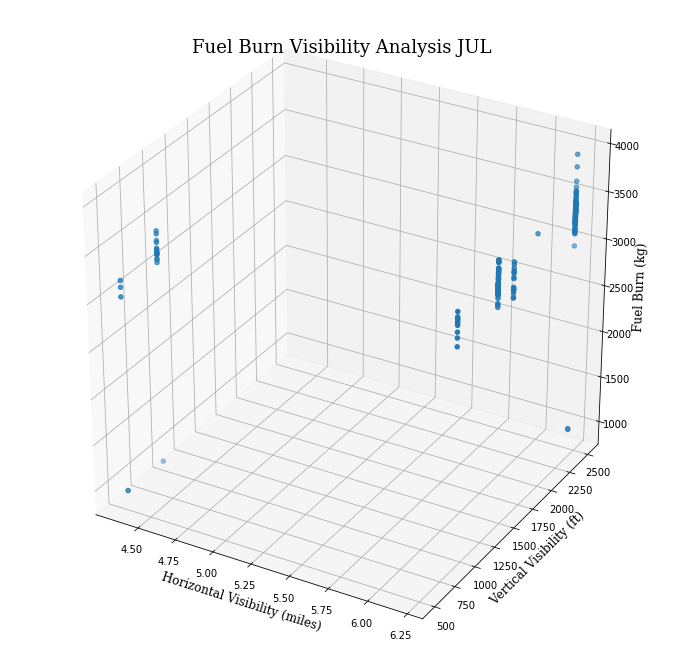

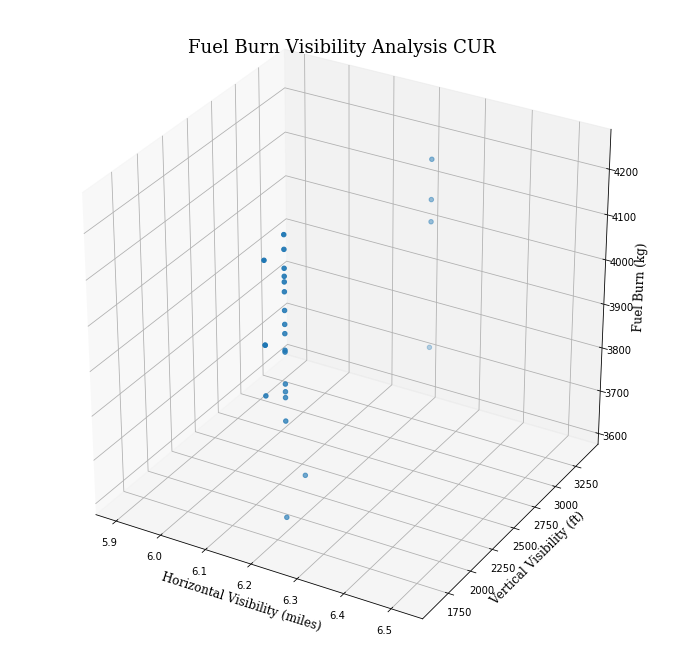

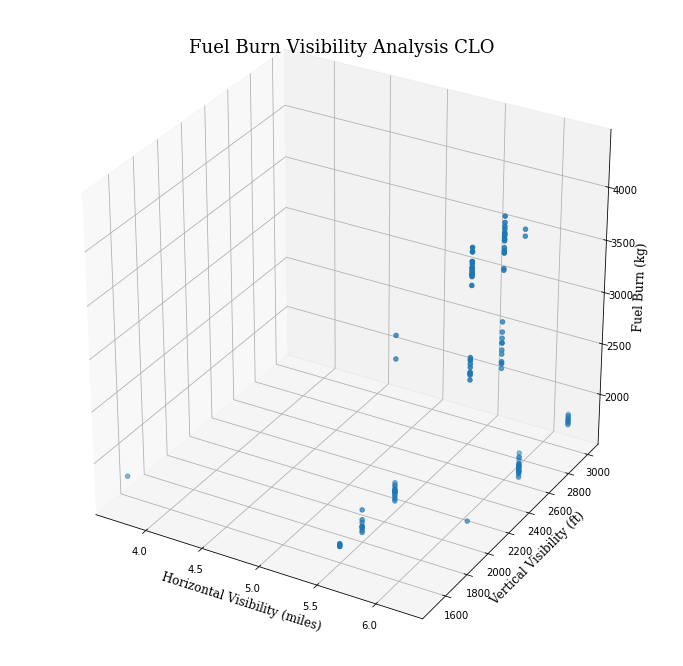

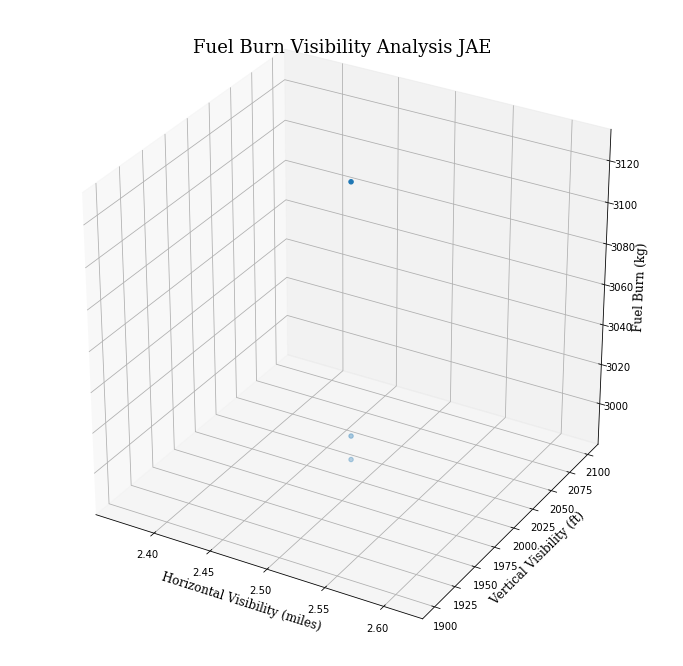

In [60]:
Target=['Add Fuel','Fuel Burn']
Test=['All']+list(Master['D'].unique())

for j in Target:
    for k in Test:
        ThirdGraph(Test=k,Target=j)
        

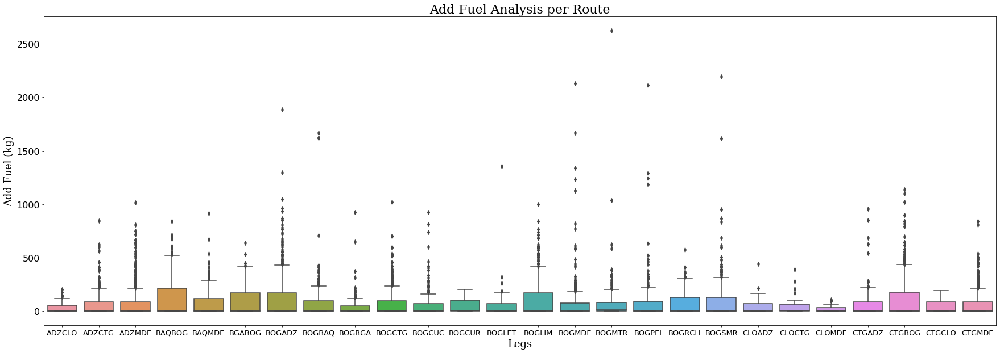

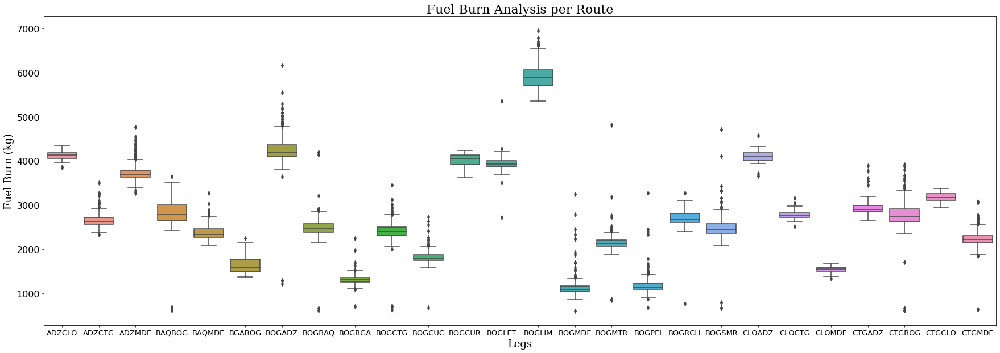

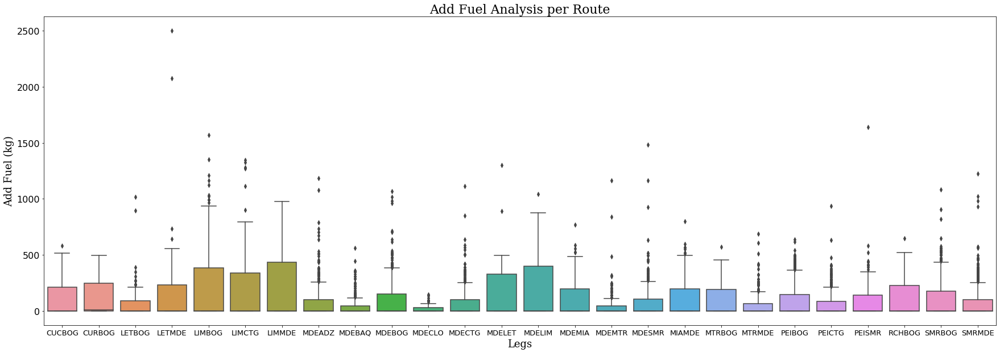

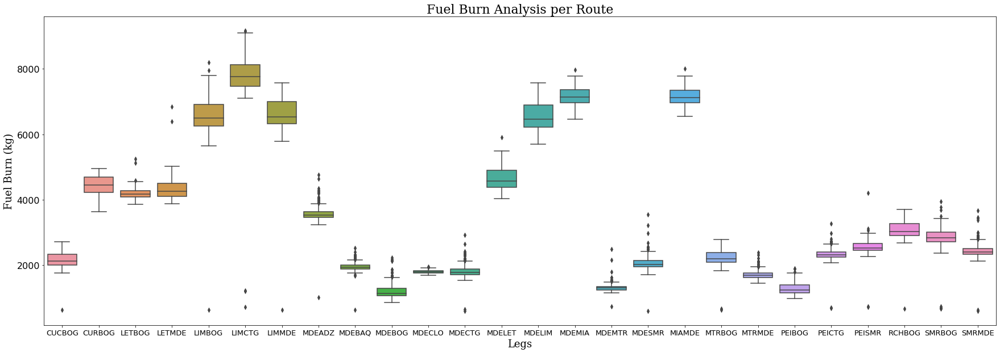

In [92]:

Routes=list(Master[Master['Op']=="VVC"]['Leg'].unique())
Routes.sort()

Target=['Add Fuel','Fuel Burn']
Sets=2
SubLegs={}

for j in range(0,Sets):    
    
    SubLegs[j]=Routes[0+j*int(np.floor(len(Routes)/Sets))+1:(j+1)*int(np.floor(len(Routes)/Sets))]

    for i in Target:
        
        ax=plt.figure(figsize=(30,10))
        filter1=((Master['Leg'].isin(SubLegs.get(j))))

        x=Master[filter1]['Leg']
        y=Master[filter1][i]

        ax=sns.boxplot(x, y,order=SubLegs.get(j))

        plt.yticks(fontsize=16)
        plt.xticks(fontsize=13)

        ax.set_ylabel(i+" (kg)",family='serif',size=18)
        ax.set_xlabel('Legs',family='serif',size=18)
        ax.set_title(i+" Analysis per Route",family='serif',size=22)
        
        my_file=i+" Analysis per Route "+str(j)+'.png'
        dir2=os.getcwd()+"/Boxplot Graphs" 
        plt.savefig(os.path.join(dir2, my_file))

In [93]:
def LF_TripTime_Graph(Test='All',Target='Fuel Burn'):
    fig = plt.figure(figsize=(12, 12))
    ax = fig.gca(projection='3d')
    
    if Test=='All':
        y=Master['LF']
        x=Master['Flight Time']
        z=Master[Target]
    else:
        y=Master[Master['Leg']==Test]['LF']
        x=Master[Master['Leg']==Test]['Flight Time']
        z=Master[Master['Leg']==Test][Target]

    ax.set_ylabel('Load Factor (%)',family='serif',size=12)
    ax.set_xlabel('Flight Time (min)',family='serif',size=12)
    ax.set_zlabel(Target+" (kg)",family='serif',size=12)
    ax.set_title(Target+" Analysis "+Test,family='serif',size=18)

    ax.scatter(x,y,z)
    
    ax = plt.gca()
    ax.set_xlim(ax.get_xlim()[::-1])
        
    my_file=Target+" Analysis "+Test+'.png'
    dir2=os.getcwd()+"/Load Factor Graphs"
    plt.savefig(os.path.join(dir2, my_file))
    

C:\Users\camilo.quiroga\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


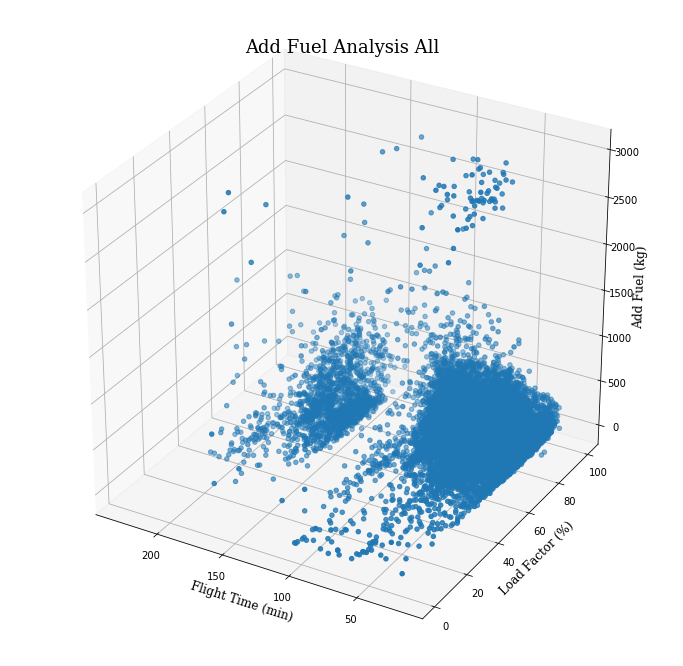

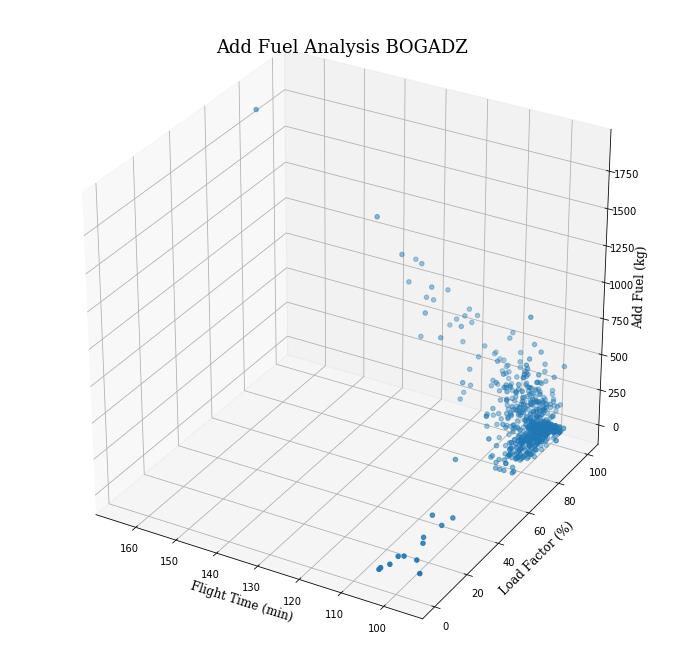

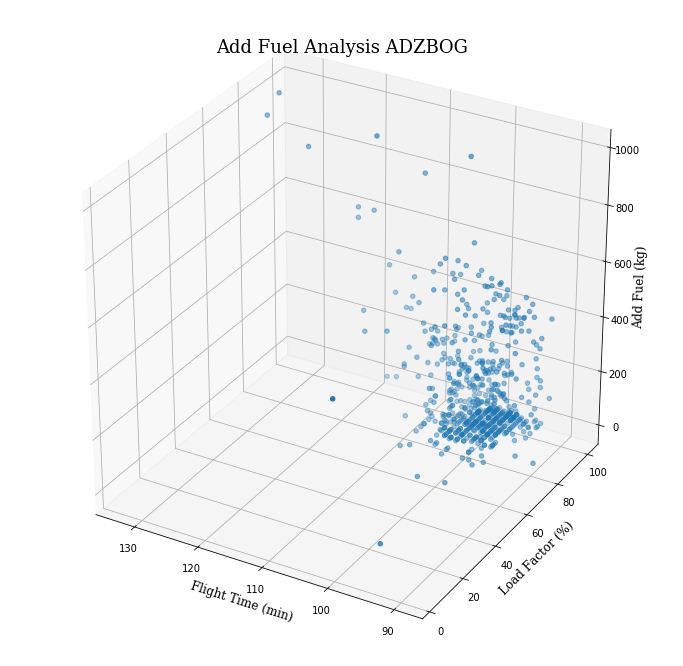

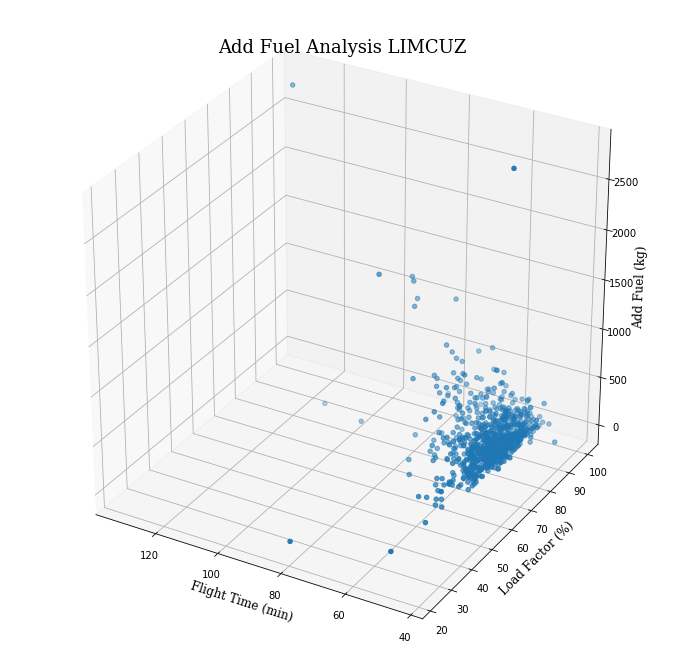

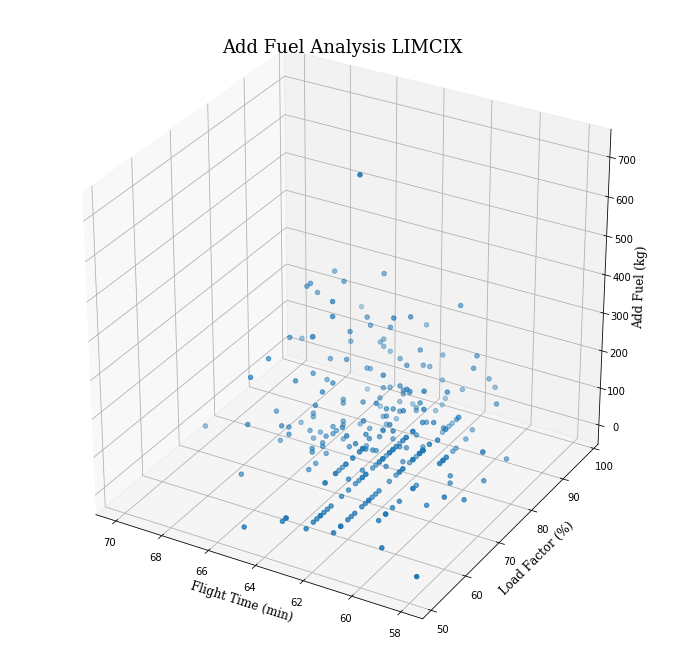

...

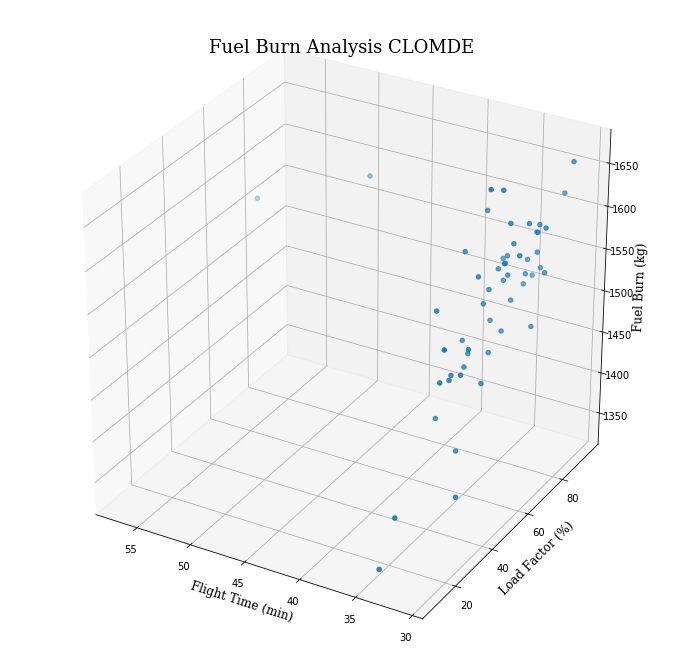

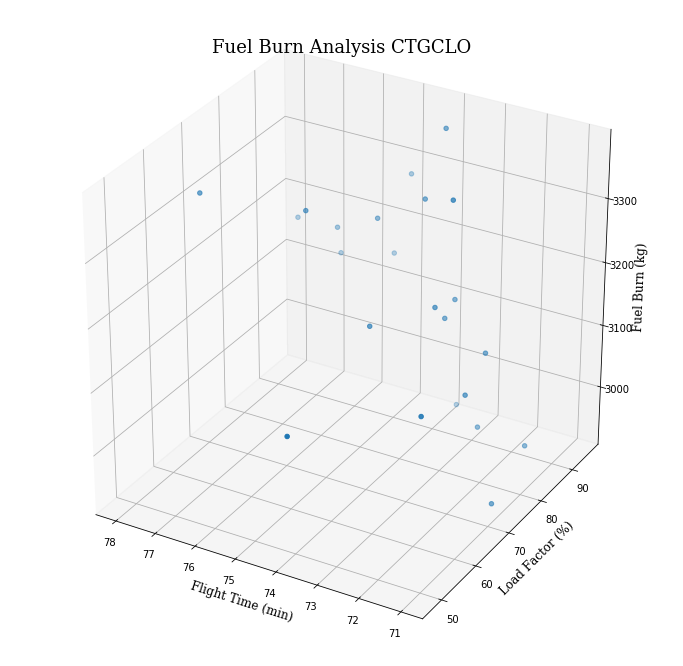

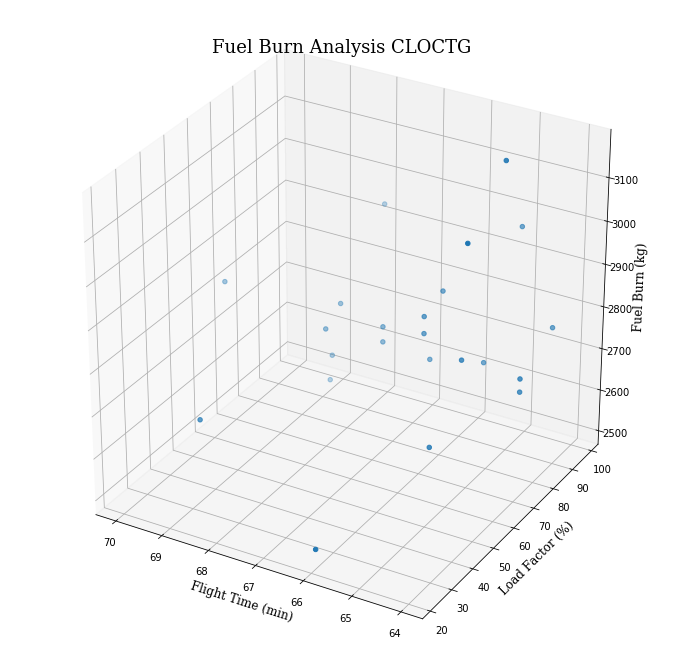

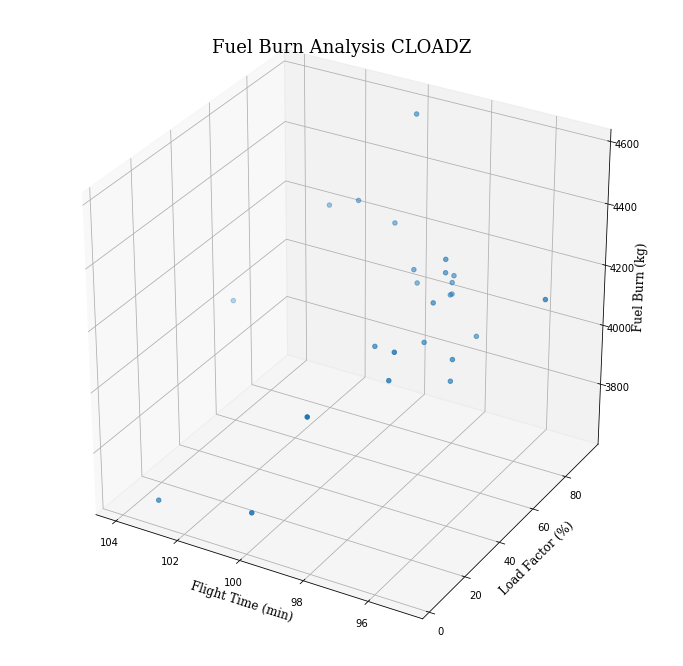

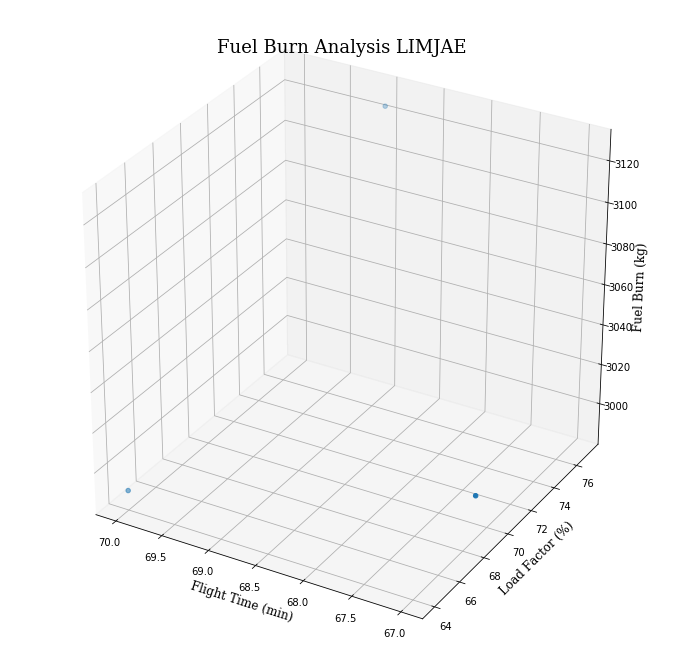

In [94]:
Target=['Add Fuel','Fuel Burn']
Test=['All']+list(Master['Leg'].unique())

for j in Target:
    for k in Test:
        LF_TripTime_Graph(Test=k,Target=j)